# Deep Learning ICA

In this notebook, we will be comparing the output of two different GANs, FCGAN (Fully Connected GAN) and DCGAN (Deep convolution GAN), on several standard machine learning datasets:
- MNIST
- Fashion MNIST
- CIFAR10
- CIFAR100


# Introduction to GANs



Generative Adversarial Networks (GANs) are used for generating images, among other things. 

GANs have two main parts:

1. The Generator: This generator takes in a noisy vector as input (random numbers), and tries to generate an image. The intitial images will be noise, so we train this network via the discriminator.

2. The Discriminator: The discriminator takes an image as input and tries to identify whether it is fake (generated by the GAN) or real (from our dataset of images).

Each network tries to improve it's respective goal, and improve over time. Once we are done training, we feed a random noise vector into the generator, and it outputs realistic images.

GAN architectures include:

1. FCGAN - A simple GAN (described above), using Dense layers and standard sequential models for generation. 

2. DCGAN - A simple GAN, using convolutional layers, which are much more powerful at generating images. 

3. Cycle GAN 

4. Style GAN 

# Setup environment

We recommend switching to GPU and mounting Google Drive.

In [1]:
# Import libraries.

import tensorflow as tf
import keras
from keras.optimizers import Adam

from keras.models import Sequential
from keras.layers.advanced_activations import LeakyReLU
from keras.initializers import RandomNormal
from keras.layers import Dense, Conv2D, Flatten, Reshape, Dropout, Conv2DTranspose, Reshape
from keras.layers import Input
from keras.models import Model
from keras.utils.vis_utils import plot_model

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

import os

# config = tf.compat.v1.ConfigProto()
# config.gpu_options.per_process_gpu_memory_fraction = 0.8
# session = tf.compat.v1.Session(config=config)

config = tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth = True
session = tf.compat.v1.Session(config=config)




np.random.seed(10)  # For reproducable random numbers.

In [2]:
# Import datasets.

from keras.datasets import mnist
from keras.datasets import fashion_mnist
from keras.datasets import cifar10
from keras.datasets import cifar100

In [3]:
if tf.test.gpu_device_name():
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
    physical_device = tf.config.experimental.list_physical_devices('GPU')
    print(f'Device found : {physical_device}')
    
else:
    print("Please install GPU version of TF")

Default GPU Device: /device:GPU:0
Device found : [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]



# FCGANs

FCGAN architectue: 
- First we will create a generator using 4 dense layers. 
- The activation for the hidden layers will be LeakyReLU with a negative slope of 0.2 (as recommended in the original paper).
- The output layer has a tanh activation and (not sigmoid) because pixel values are from -1 to 1 (we normalised the data), not 0 to 1.
- The discriminator will be similar, but use a different number of neurons.
- The generator and the discriminator are then combined. The reason is that the loss (feedback on whether the generator was good) has to flow from the discriminator. 
- Finally, the GAN is trained. The first for loop is meant for the number of epochs (iterations over training set). The second for loop is to split the training set into the number of batches we chose. The loss for the discriminator and generator are printed after every epoch.

Results are discussed in the final section.

## MNIST

In [4]:
# Set variables.
noise_dim = 100  # Input dimension of random vector, which goes into the generator.

batch_size = 16   # Number of images in each batch.
steps_per_epoch = 3750  # Number of steps per iteration of the training set (number of batches).
epochs = 10      # Number of training iterations.

# Change the values below to the dimensions of the image. The channels number refers to the number of colors.
img_rows, img_cols, channels = 28, 28, 1

# Recommended values for the optimizer.
optimizer = Adam(0.0002, 0.5)

### Load the funtions

In [5]:
# Create generator.
def create_generator():
    generator = Sequential()

    generator.add(Dense(256, input_dim=noise_dim))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(512))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(1024))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(img_rows*img_cols*channels, activation='tanh'))  # The output layer has the same number of neurons as pixels in the image, because each neuron produces the color value for each pixel
    
    generator.compile(loss='binary_crossentropy', optimizer=optimizer) # A standard cross entropy loss would work, because the feedback it is getting is whether it fooled the discriminator or not.
    
    return generator
    

In [6]:
# Create discriminator.
def create_discriminator():
    discriminator = Sequential()
    
    discriminator.add(Dense(1024, input_dim=img_rows*img_cols*channels))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Dense(512))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Dense(256))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Dense(1, activation='sigmoid'))  #sigmoid activation as output is 0/1, fake/real
    
    discriminator.compile(loss='binary_crossentropy', optimizer = optimizer)  #Binary Cross entropy loss as the discriminator has to try and classify all images (real or fake) in the right category
    
    return discriminator

In [7]:
def combine_architecture(generate, discriminate):
    # Combine the generator and discriminator to make a single large gan (loss and derivatives have to flow from discriminator to generator).

    generator = generate()           # Create the generator.
    discriminator = discriminate()   # Create the discriminator.
    
    discriminator.trainable = False          # Set to false, so that when we train the entire GAN together, only the generator part will be trained. We will train the discriminator separately. See below code block for more details.

    gan_input = Input(shape=(noise_dim,))    # We set the input of the whole model as the noise vector that the generator takes in as input, as the generator first has to develop an image for training to start.
    fake_image = generator(gan_input)        #Image generated by GAN for this noise vector is stored in fake_image

    gan_output = discriminator(fake_image)   # The output of the GAN is the discriminator.

    gan = Model(gan_input, gan_output)       # Finally putting the generator and discriminator together.
    gan.compile(loss='binary_crossentropy', optimizer=optimizer)  # Using binary cross entropy loss (same as discriminator loss).
    return gan, generator, discriminator

In [8]:
# Function to plot results.
def show_images(generator, noise, size_fig):
    generated_images = generator.predict(noise)   # Create the images from the GAN.
    plt.figure(figsize=size_fig)
    
    for i, image in enumerate(generated_images):
        plt.subplot(size_fig[0], size_fig[1], i+1)
        if channels == 1:
            plt.imshow(image.reshape((img_rows, img_cols)), cmap='gray')    # If the image is grayscale, then we will reshape the output in the following way.
                                                                            # Also, we set the coloring to grayscale.
        else:
            image = image.reshape(img_rows, img_cols, channels)
            image = (image.astype(np.float32) * 127.5) + 127.5  # un-normalise data
            image = image.astype(int)
            plt.imshow(image)
        plt.axis('off')
    
    plt.tight_layout()   # Tight layout to form a grid.
    plt.show()
    

In [9]:
# Here we import the required modules to permutate FID score which is a 
# quatitative way to compare GAN image quality.

from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input
# prepare the inception v1 model
model = InceptionV3(include_top=False, pooling='avg', input_shape=(75,75,3))

In [10]:
# calculate frechet inception distance

from numpy import cov
from numpy import trace
from numpy import iscomplexobj
from numpy.random import random
from scipy.linalg import sqrtm

def calculate_fid(model, images1, images2):
    if images1.ndim == 5:
        images1 = images1[:, :, :, :, 0]
        images2 = images2[:, :, :, :, 0]

     # calculate activations
    act1 = model.predict(images1)
    act2 = model.predict(images2)
    # calculate mean and covariance statistics
    mu1, sigma1 = act1.mean(axis=0), cov(act1, rowvar=False)
    mu2, sigma2 = act2.mean(axis=0), cov(act2, rowvar=False)
    # calculate sum squared difference between means
    ssdiff = np.sum((mu1 - mu2)**2.0)
    # calculate sqrt of product between cov
    covmean = sqrtm(sigma1.dot(sigma2))
    # check and correct imaginary numbers from sqrt
    if iscomplexobj(covmean):
        covmean = covmean.real
    # calculate score
    fid = ssdiff + trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

In [11]:
from skimage.transform import resize
from numpy import asarray

# scale an array of images to a new size
def scale_images(images, new_shape):
    images_list = list()
    for image in images:
        # resize with nearest neighbor interpolation
        new_image = resize(image, new_shape, 0)
        # store
        images_list.append(new_image)
    return asarray(images_list)

In [12]:
def train_and_plot_results(gan, generator, discriminator):
    """Function takes the merged network 'gan' and a created 'generator' and 'discriminator', 
    trains our model, prints the losses as well as the images generated by the gan to let us
    monitor improvement per epoch.
    
    Function then returns a dataframe of the losses, the real and the fake images after the 
    training (as numpy of course). The fake images will be used to compare other fake images 
    produced by both GANS (fc and dc)
    """
    
    # Create dataframe to save loss.
    df = pd.DataFrame()

    # Train model.
    for epoch in range(epochs):         # Iterate the dataset for the number of epochs.

        images1 = []    # instantiate lists for fake and real for FID and inception score permutation
        images2 = []

        for batch in range(steps_per_epoch):    # for the number of batches we wanted to create
            noise = np.random.normal(0, 1, size=(batch_size, noise_dim))   # We generate a new noise vector to feed the generator before every training iteration
            fake_x = generator.predict(noise)        # The image the generator develops for the noise vector we created above

            real_x = x_train[np.random.randint(0, x_train.shape[0], size=batch_size)]  #We won't use all real images from our dataset at once, we will only select a random sample of images
            
            images1.append(real_x)
            images2.append(fake_x)

            x = np.concatenate((real_x, fake_x))    #making the x dataset for the discriminator. This includes a mix of real and fake examples for the discriminator to correctly classify

            disc_y = np.zeros(2*batch_size)
            disc_y[:batch_size] = 0.9

            d_loss = discriminator.train_on_batch(x, disc_y)   #We are training the discriminator separately. Remember, we set trainable = false when adding it to the GAN, so that when we train the GAN, we only train the generator. Hence this extra step

            y_gen = np.ones(batch_size)
            g_loss = gan.train_on_batch(noise, y_gen)       #Now we train the entire GAN. But since the discriminator can't be trained, only the generator is trained in this step.

        if real_x.ndim == 2:
            print("You are on FC-GAN")
            if channels == 1:
                print("You are handling gray scale images")
                # Add channel
                images1 = np.stack((images1,)*3, axis=-1)
                images2 = np.stack((images2,)*3, axis=-1)
            
            # resize images (FID requires at least dim = (75, 75, 3))
            images1 = scale_images(images1, (75,75,3))
            images2 = scale_images(images2, (75,75,3))
        
        else:
            print("You are on DC-GAN")
            # resize images
            images1 = scale_images(images1, (75,75,3))
            images2 = scale_images(images2, (75,75,3))
        # pre-process images
        images1 = preprocess_input(images1)
        images2 = preprocess_input(images2)
        
        # fid between real images and fake images per epoch
        fid = calculate_fid(model, images1, images2)

        print(f'Epoch: {epoch + 1} \t Discriminator Loss: {round(d_loss, 3)} \t Generator Loss: {round(g_loss, 3)} \t FID score: {round(fid, 3)}')

        # For every epoch, append losses to dataframe 
        new_row = [[epoch, d_loss, g_loss, fid]]
        df = df.append(new_row)

        noise = np.random.normal(0, 1, size=(25, noise_dim))
        show_images(generator, noise, (5, 5))
    
    df.columns=['epoch', 'd_loss', 'g_loss', 'fid']
    return df, images1, images2

In [13]:
(x_train, y_train), (x_test, y_test) = mnist.load_data()     # Loading data.

x_train = (x_train.astype(np.float32) - 127.5) / 127.5      # Normalising the data between -1 to 1. NNs converge faster this way.

x_train = x_train.reshape(-1, img_rows*img_cols*channels)    # The data is in an image style format, so we need to reshape it into a vector.

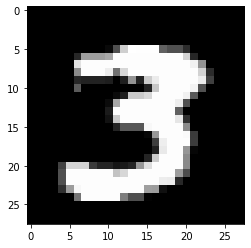

In [14]:
image = x_train[27]
plt.imshow(image.reshape((img_rows, img_cols)), cmap='gray')

### Merge Geneator and Discriminator

In [15]:
fc_mnist_gan, fc_mnist_generator, fc_mnist_discriminator = combine_architecture(create_generator, create_discriminator)

### Train and Print Results

You are on FC-GAN
You are handling gray scale images
Epoch: 1 	 Discriminator Loss: 0.647 	 Generator Loss: 1.71 	 FID score: 31.223


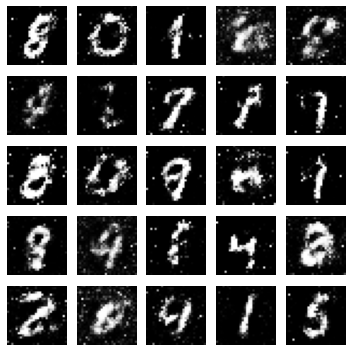

You are on FC-GAN
You are handling gray scale images
Epoch: 2 	 Discriminator Loss: 0.604 	 Generator Loss: 1.22 	 FID score: 8.426


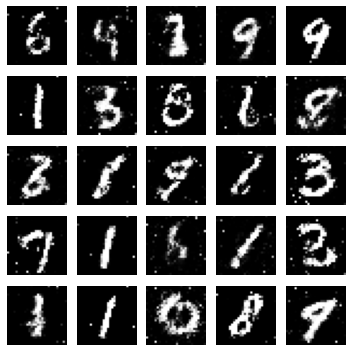

You are on FC-GAN
You are handling gray scale images
Epoch: 3 	 Discriminator Loss: 0.616 	 Generator Loss: 1.44 	 FID score: 6.194


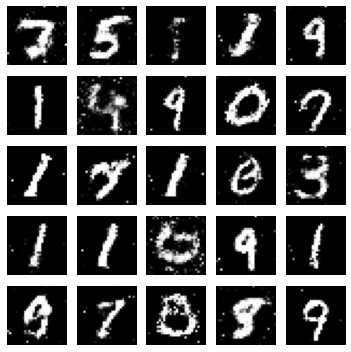

You are on FC-GAN
You are handling gray scale images
Epoch: 4 	 Discriminator Loss: 0.572 	 Generator Loss: 1.55 	 FID score: 4.408


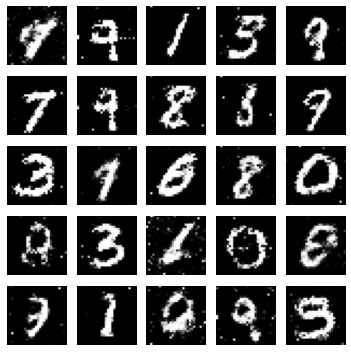

You are on FC-GAN
You are handling gray scale images
Epoch: 5 	 Discriminator Loss: 0.639 	 Generator Loss: 1.495 	 FID score: 3.561


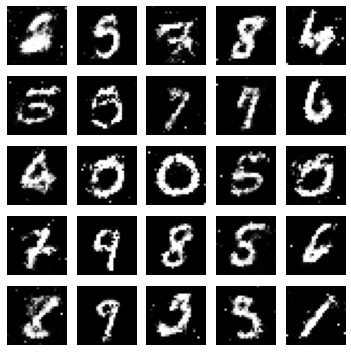

You are on FC-GAN
You are handling gray scale images
Epoch: 6 	 Discriminator Loss: 0.617 	 Generator Loss: 1.508 	 FID score: 3.051


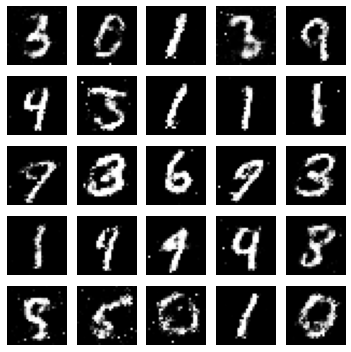

You are on FC-GAN
You are handling gray scale images
Epoch: 7 	 Discriminator Loss: 0.513 	 Generator Loss: 1.596 	 FID score: 3.239


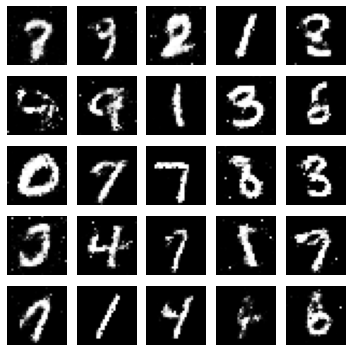

You are on FC-GAN
You are handling gray scale images
Epoch: 8 	 Discriminator Loss: 0.523 	 Generator Loss: 1.531 	 FID score: 3.401


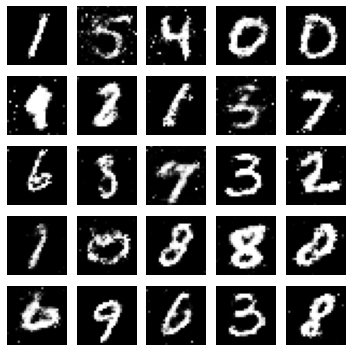

You are on FC-GAN
You are handling gray scale images
Epoch: 9 	 Discriminator Loss: 0.52 	 Generator Loss: 1.431 	 FID score: 3.001


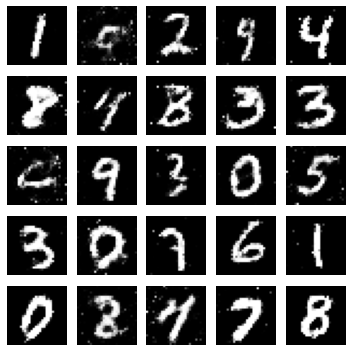

You are on FC-GAN
You are handling gray scale images
Epoch: 10 	 Discriminator Loss: 0.596 	 Generator Loss: 1.281 	 FID score: 2.738


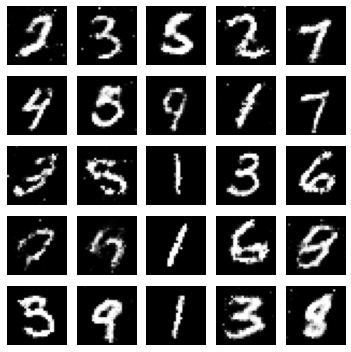

In [16]:
fc_mnist, fc_mnist_real, fc_mnist_fake = train_and_plot_results(fc_mnist_gan, fc_mnist_generator, fc_mnist_discriminator)

In [17]:
fc_mnist

,epoch,d_loss,g_loss,fid
0,0,0.646829,1.710107,31.223388
0,1,0.603545,1.220051,8.426175
0,2,0.616037,1.440096,6.194346
0,3,0.572330,1.550251,4.408346
0,4,0.638979,1.494821,3.560992
0,5,0.616730,1.508489,3.051395
0,6,0.512946,1.595669,3.239134
0,7,0.522956,1.530609,3.401159
0,8,0.520428,1.431122,3.001089
0,9,0.595963,1.281278,2.737715


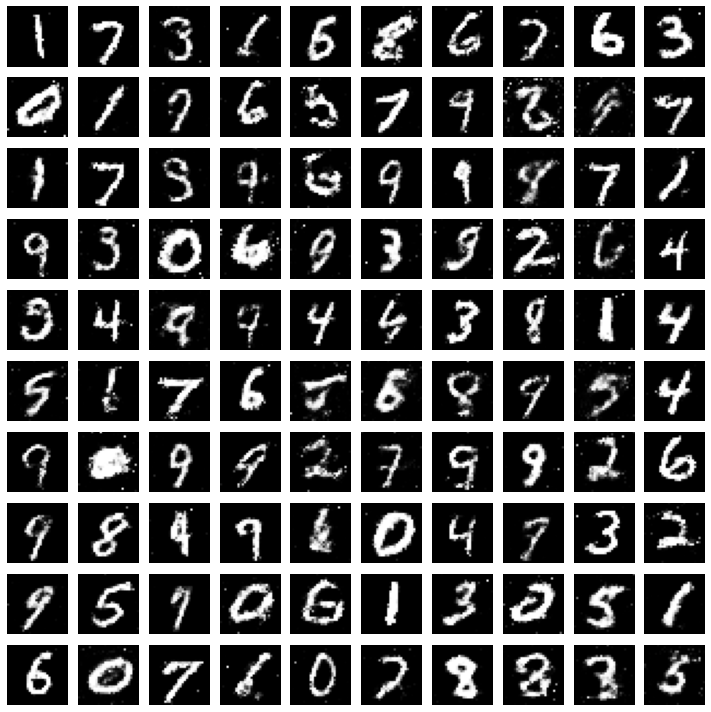

In [18]:
# Plot results again.
noise = np.random.normal(0, 1, size=(100, noise_dim))
show_images(fc_mnist_generator, noise, size_fig=(10, 10))

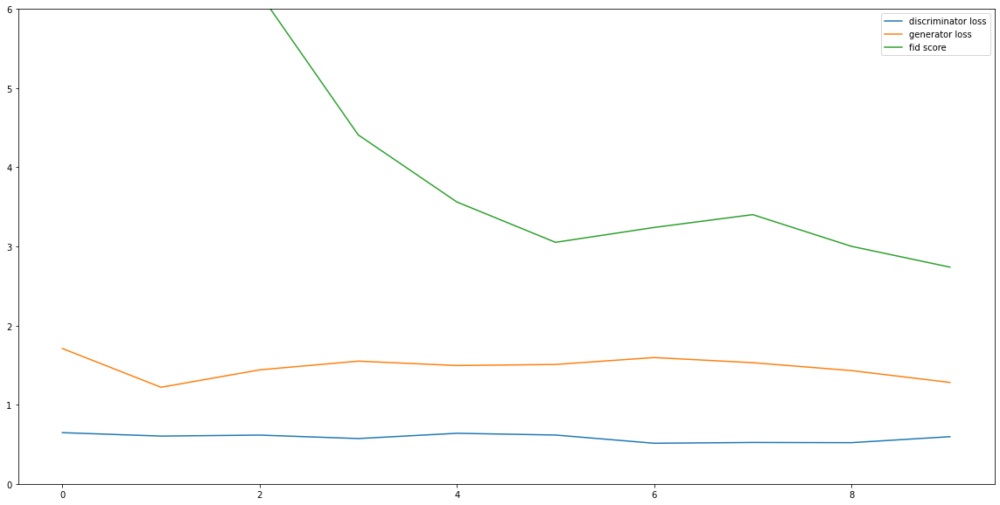

In [19]:
# Plot losses.
plt.figure(figsize=(20, 10))
plt.plot(fc_mnist['epoch'], fc_mnist['d_loss'], label='discriminator loss')
plt.plot(fc_mnist['epoch'], fc_mnist['g_loss'], label='generator loss')
plt.plot(fc_mnist['epoch'], fc_mnist['fid'], label='fid score')
#plt.xlim([0, 1])
plt.ylim([0, 6])
plt.legend()
plt.show()

### Model visualisation

In [20]:
print('Architectures')
print(' ')
print('--- Generator ---')
print(fc_mnist_generator.summary())
print(' ')
print('--- Discriminator ---')
print(fc_mnist_discriminator.summary())
print(' ')
print('--- GAN ---')
print(fc_mnist_gan.summary())

Architectures
 
--- Generator ---
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 256)               25856     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 512)               131584    
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 1024)              525312    
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 1024)              0         
_________________________________________________________________
dense_3 (Dense)       

Architectures
 
--- Generator ---


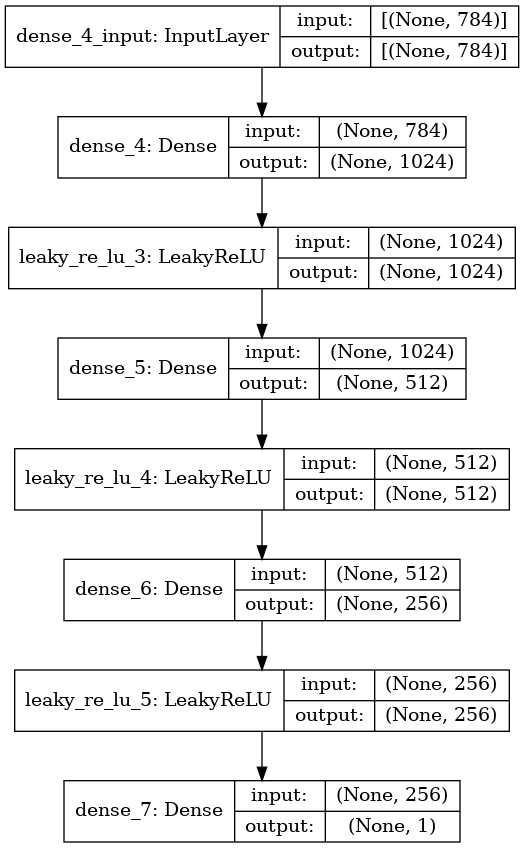

In [21]:
print('Architectures')
print(' ')
print('--- Generator ---')
plot_model(fc_mnist_discriminator, show_shapes=True, show_layer_names=True)


--- Discriminator ---


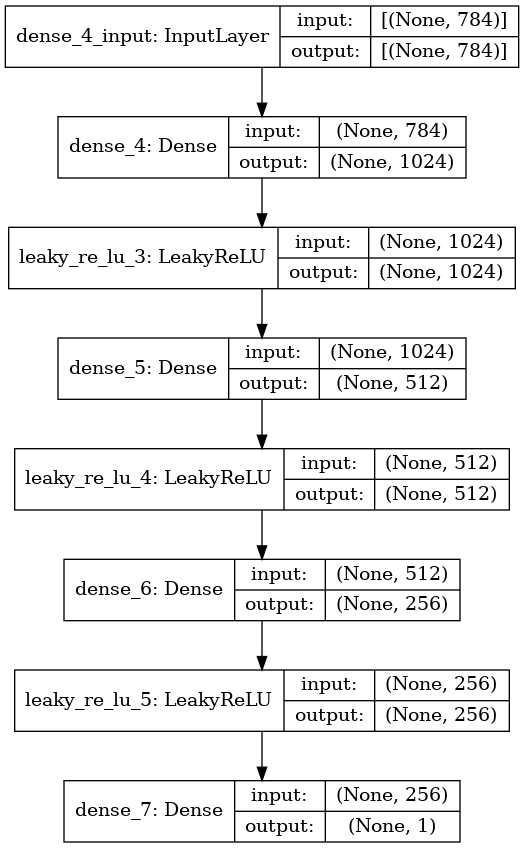

In [22]:
print('--- Discriminator ---')
plot_model(fc_mnist_discriminator, show_shapes=True, show_layer_names=True)

--- GAN ---


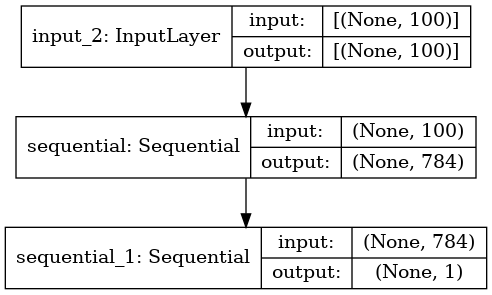

In [23]:
print('--- GAN ---')
plot_model(fc_mnist_gan, show_shapes=True, show_layer_names=True)

## Fashion MNIST

In [24]:
(x_train, y_train), (x_test, y_test) = fashion_mnist.load_data()     

x_train = (x_train.astype(np.float32) - 127.5) / 127.5      

x_train = x_train.reshape(-1, img_rows*img_cols*channels)    

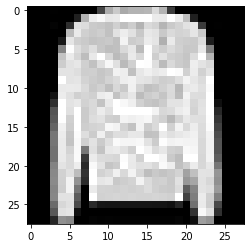

In [25]:
image = x_train[27]
plt.imshow(image.reshape((img_rows, img_cols)), cmap='gray')

### Merge Geneator and Discriminator

In [26]:
fc_fashion_mnist_gan, fc_fashion_mnist_generator, fc_fashion_mnist_discriminator = combine_architecture(create_generator, create_discriminator)

### Train and Print Results

You are on FC-GAN
You are handling gray scale images
Epoch: 1 	 Discriminator Loss: 0.66 	 Generator Loss: 1.479 	 FID score: 14.206


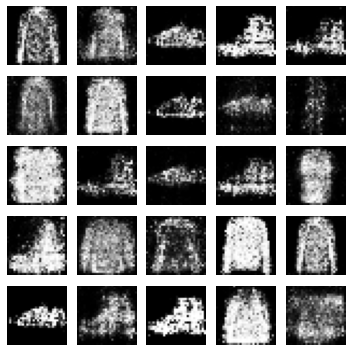

You are on FC-GAN
You are handling gray scale images
Epoch: 2 	 Discriminator Loss: 0.57 	 Generator Loss: 1.346 	 FID score: 4.808


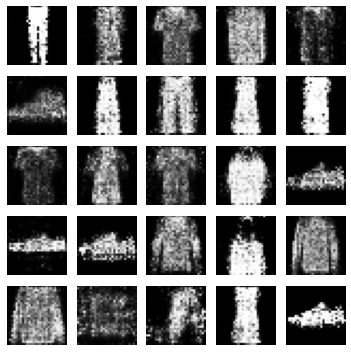

You are on FC-GAN
You are handling gray scale images
Epoch: 3 	 Discriminator Loss: 0.682 	 Generator Loss: 1.165 	 FID score: 6.126


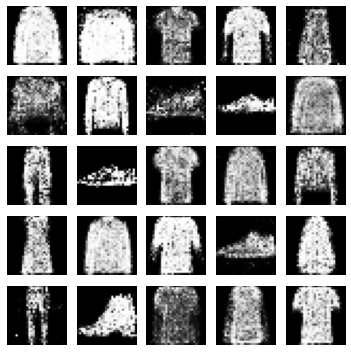

You are on FC-GAN
You are handling gray scale images
Epoch: 4 	 Discriminator Loss: 0.567 	 Generator Loss: 1.354 	 FID score: 4.483


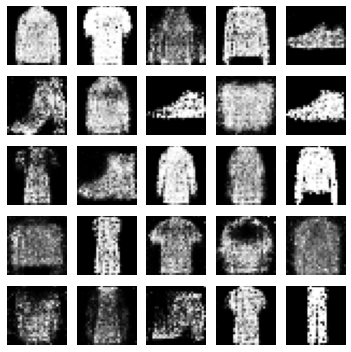

You are on FC-GAN
You are handling gray scale images
Epoch: 5 	 Discriminator Loss: 0.63 	 Generator Loss: 1.331 	 FID score: 3.622


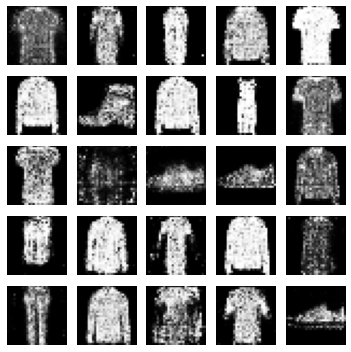

You are on FC-GAN
You are handling gray scale images
Epoch: 6 	 Discriminator Loss: 0.536 	 Generator Loss: 1.462 	 FID score: 3.217


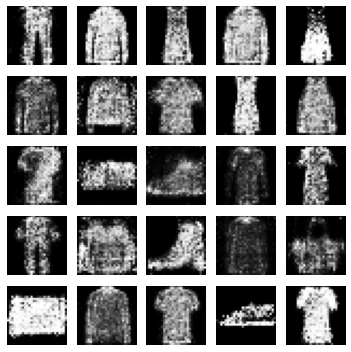

You are on FC-GAN
You are handling gray scale images
Epoch: 7 	 Discriminator Loss: 0.655 	 Generator Loss: 1.426 	 FID score: 4.167


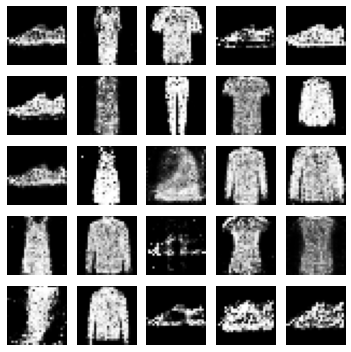

You are on FC-GAN
You are handling gray scale images
Epoch: 8 	 Discriminator Loss: 0.54 	 Generator Loss: 1.356 	 FID score: 3.764


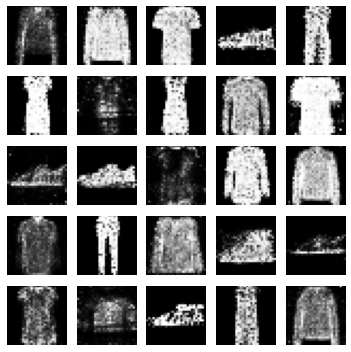

You are on FC-GAN
You are handling gray scale images
Epoch: 9 	 Discriminator Loss: 0.652 	 Generator Loss: 1.415 	 FID score: 3.798


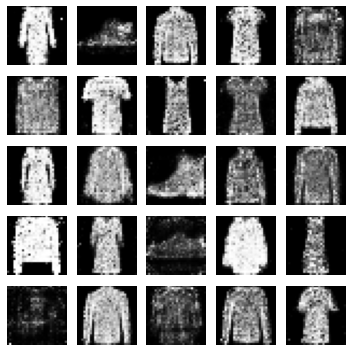

You are on FC-GAN
You are handling gray scale images
Epoch: 10 	 Discriminator Loss: 0.523 	 Generator Loss: 1.466 	 FID score: 4.07


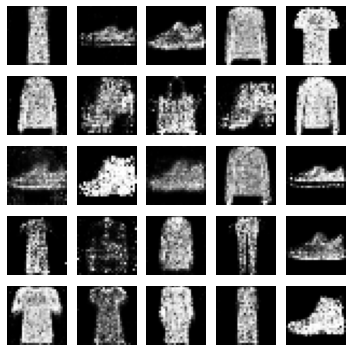

In [27]:
fc_fashion_mnist, fc_fashion_mnist_real, fc_fashion_mnist_fake = train_and_plot_results(fc_fashion_mnist_gan, fc_fashion_mnist_generator, fc_fashion_mnist_discriminator)

In [28]:
fc_fashion_mnist

,epoch,d_loss,g_loss,fid
0,0,0.659992,1.478670,14.206116
0,1,0.569628,1.346211,4.807898
0,2,0.682157,1.164714,6.125926
0,3,0.566932,1.354420,4.483045
0,4,0.630213,1.330595,3.622263
0,5,0.535933,1.461572,3.217391
0,6,0.655133,1.425816,4.166781
0,7,0.539979,1.355941,3.763886
0,8,0.652208,1.414740,3.798262
0,9,0.523414,1.465650,4.070218


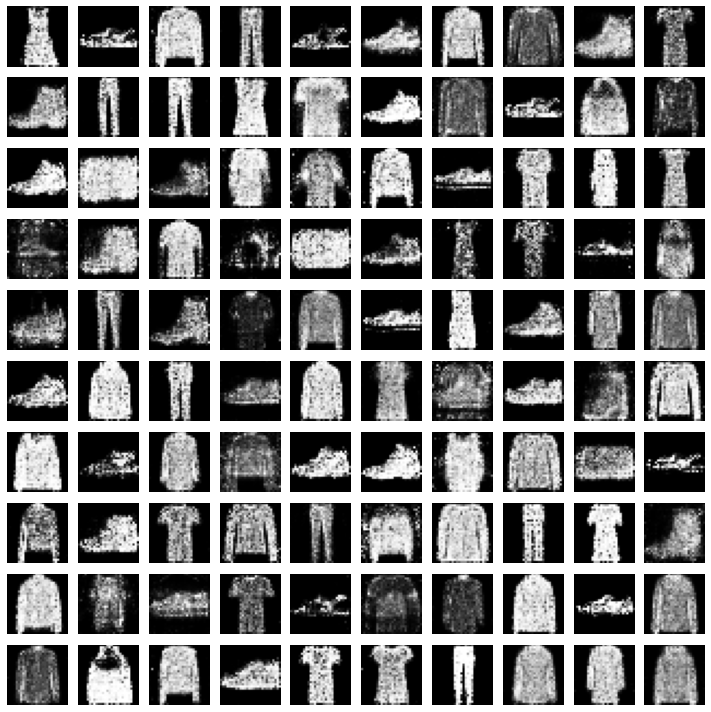

In [29]:
noise = np.random.normal(0, 1, size=(100, noise_dim))
show_images(fc_fashion_mnist_generator, noise, size_fig=(10, 10))

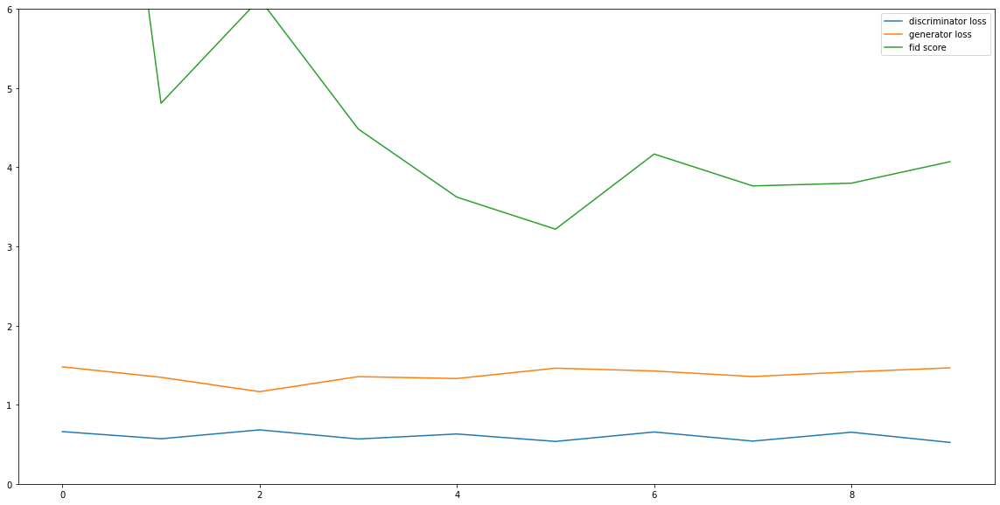

In [30]:
# Plot losses.
plt.figure(figsize=(20, 10))
plt.plot(fc_fashion_mnist['epoch'], fc_fashion_mnist['d_loss'], label='discriminator loss')
plt.plot(fc_fashion_mnist['epoch'], fc_fashion_mnist['g_loss'], label='generator loss')
plt.plot(fc_fashion_mnist['epoch'], fc_fashion_mnist['fid'], label='fid score')
#plt.xlim([0, 1])
plt.ylim([0, 6])
plt.legend()
plt.show()

### Model Visualisation

In [31]:
print('Architectures')
print(' ')
print('--- Generator ---')
print(fc_fashion_mnist_generator.summary())
print(' ')
print('--- Discriminator ---')
print(fc_fashion_mnist_discriminator.summary())
print(' ')
print('--- GAN ---')
print(fc_fashion_mnist_gan.summary())

Architectures
 
--- Generator ---
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_8 (Dense)              (None, 256)               25856     
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 256)               0         
_________________________________________________________________
dense_9 (Dense)              (None, 512)               131584    
_________________________________________________________________
leaky_re_lu_7 (LeakyReLU)    (None, 512)               0         
_________________________________________________________________
dense_10 (Dense)             (None, 1024)              525312    
_________________________________________________________________
leaky_re_lu_8 (LeakyReLU)    (None, 1024)              0         
_________________________________________________________________
dense_11 (Dense)    

Architectures
 
--- Generator ---


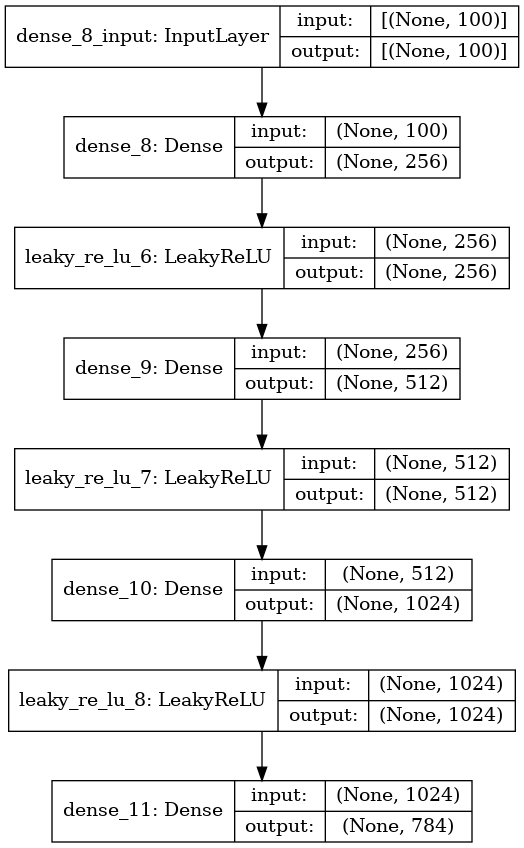

In [32]:
print('Architectures')
print(' ')
print('--- Generator ---')
plot_model(fc_fashion_mnist_generator, show_shapes=True, show_layer_names=True)


--- Discriminator ---


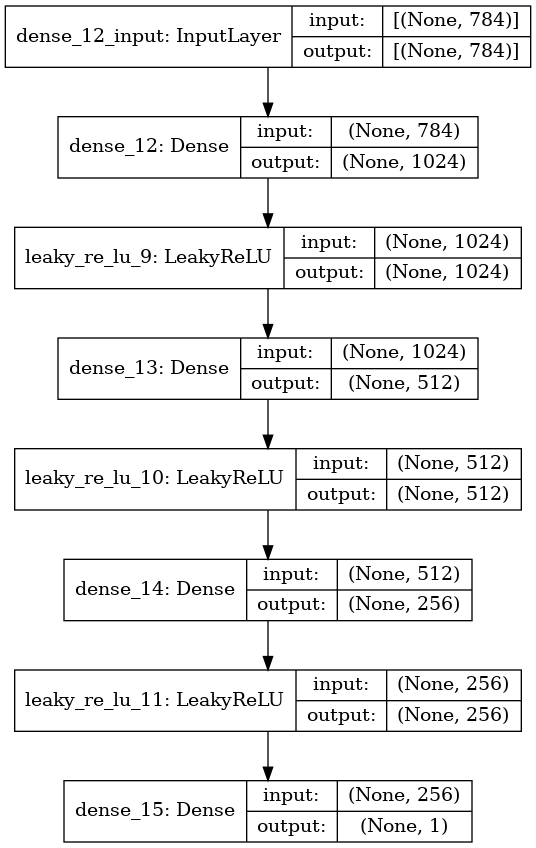

In [33]:
print('--- Discriminator ---')
plot_model(fc_fashion_mnist_discriminator, show_shapes=True, show_layer_names=True)

--- GAN ---


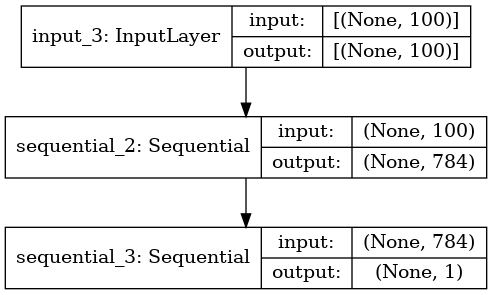

In [34]:
print('--- GAN ---')
plot_model(fc_fashion_mnist_gan, show_shapes=True, show_layer_names=True)

## CIFAR10

In [35]:
# Changed to CIFAR dimensions.
img_rows, img_cols, channels = 32, 32, 3

In [36]:
# Load Data
(x_train, y_train), (x_test, y_test) = cifar10.load_data()  

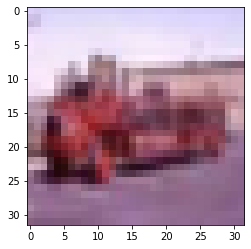

In [37]:
# View sample of image
image = x_train[67]
plt.imshow(image)

In [38]:
# rescale between -1 and 1. It converges faster this way.

x_train = (x_train.astype(np.float32) - 127.5) / 127.5      

x_train = x_train.reshape(-1, img_rows*img_cols*channels)  

### Merge Geneator and Discriminator

In [39]:
fc_cifar10_gan, fc_cifar10_generator, fc_cifar10_discriminator = combine_architecture(create_generator, create_discriminator)

### Train an Print Results

You are on FC-GAN
Epoch: 1 	 Discriminator Loss: 0.723 	 Generator Loss: 1.096 	 FID score: 17.481


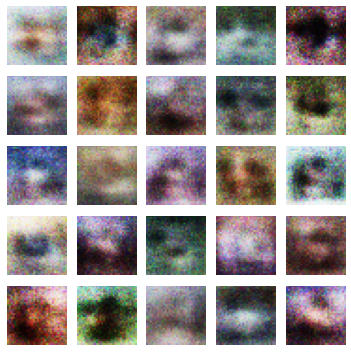

You are on FC-GAN
Epoch: 2 	 Discriminator Loss: 0.602 	 Generator Loss: 1.07 	 FID score: 3.758


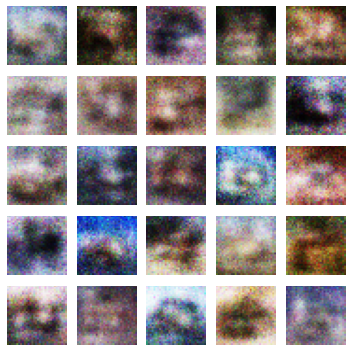

You are on FC-GAN
Epoch: 3 	 Discriminator Loss: 0.612 	 Generator Loss: 1.172 	 FID score: 3.162


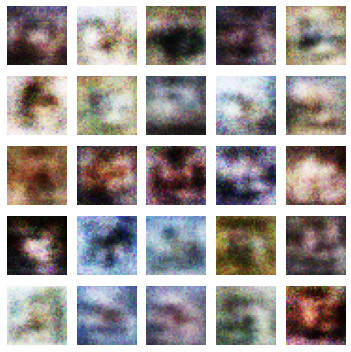

You are on FC-GAN
Epoch: 4 	 Discriminator Loss: 0.452 	 Generator Loss: 1.83 	 FID score: 6.909


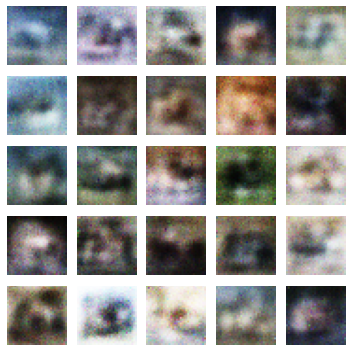

You are on FC-GAN
Epoch: 5 	 Discriminator Loss: 0.597 	 Generator Loss: 1.819 	 FID score: 4.569


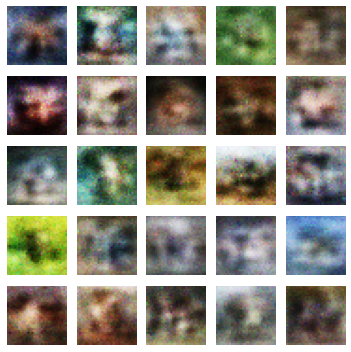

You are on FC-GAN
Epoch: 6 	 Discriminator Loss: 0.379 	 Generator Loss: 2.579 	 FID score: 3.828


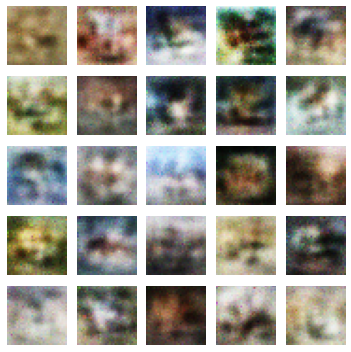

You are on FC-GAN
Epoch: 7 	 Discriminator Loss: 0.522 	 Generator Loss: 2.314 	 FID score: 4.386


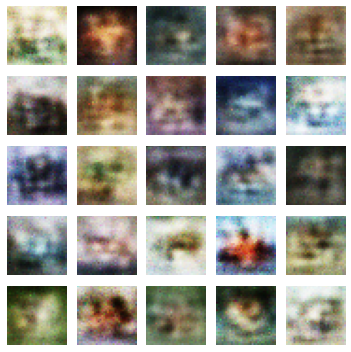

You are on FC-GAN
Epoch: 8 	 Discriminator Loss: 0.33 	 Generator Loss: 2.537 	 FID score: 5.29


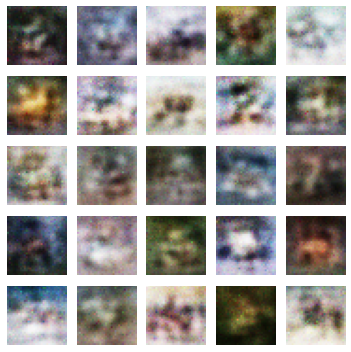

You are on FC-GAN
Epoch: 9 	 Discriminator Loss: 0.381 	 Generator Loss: 2.889 	 FID score: 5.92


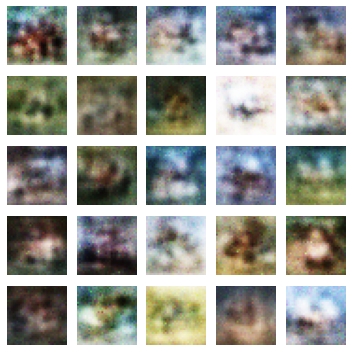

You are on FC-GAN
Epoch: 10 	 Discriminator Loss: 0.389 	 Generator Loss: 2.974 	 FID score: 7.829


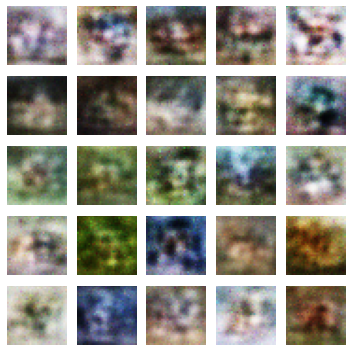

In [40]:
fc_cifar10, fc_cifar10_real, fc_cifar10_fake = train_and_plot_results(fc_cifar10_gan, fc_cifar10_generator, fc_cifar10_discriminator)

In [41]:
fc_cifar10

,epoch,d_loss,g_loss,fid
0,0,0.723031,1.095863,17.481197
0,1,0.602013,1.069625,3.757738
0,2,0.612053,1.171708,3.161538
0,3,0.451540,1.830457,6.908892
0,4,0.596692,1.818710,4.569196
0,5,0.378966,2.578752,3.828408
0,6,0.521953,2.314314,4.385569
0,7,0.329976,2.537160,5.289853
0,8,0.380966,2.889255,5.919945
0,9,0.388872,2.973984,7.829290


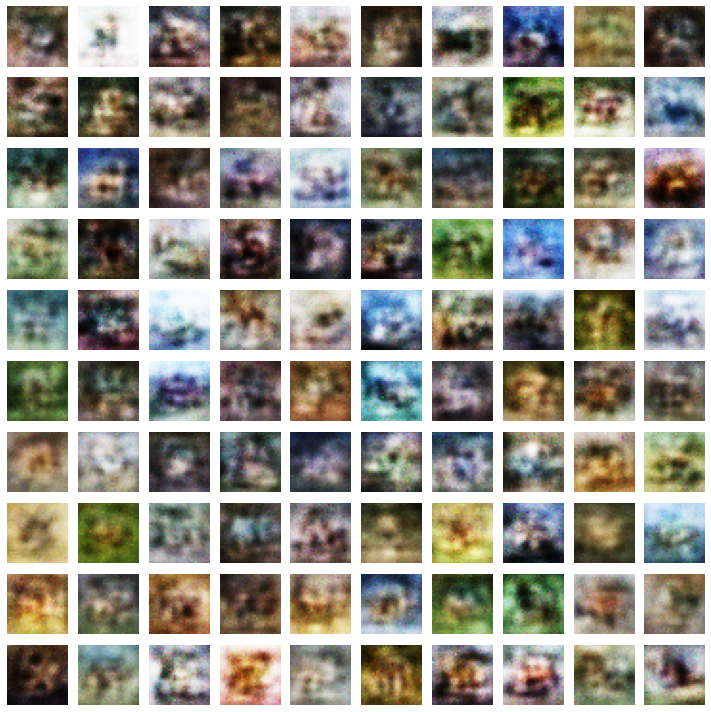

In [42]:
# Plot results again.
noise = np.random.normal(0, 1, size=(100, noise_dim))
show_images(fc_cifar10_generator, noise, size_fig=(10, 10))

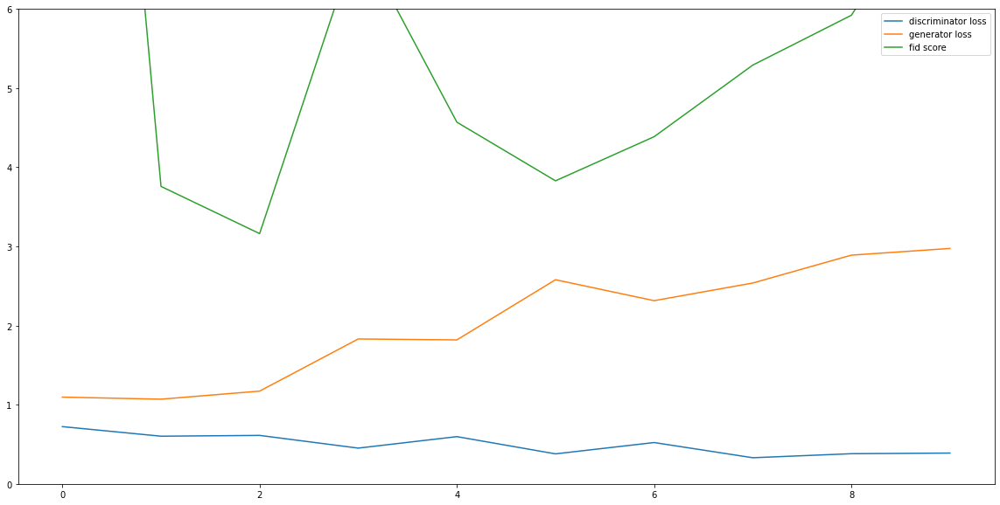

In [43]:
# Plot losses.
plt.figure(figsize=(20, 10))
plt.plot(fc_cifar10['epoch'], fc_cifar10['d_loss'], label='discriminator loss')
plt.plot(fc_cifar10['epoch'], fc_cifar10['g_loss'], label='generator loss')
plt.plot(fc_cifar10['epoch'], fc_cifar10['fid'], label='fid score')
#plt.xlim([0, 1])
plt.ylim([0, 6])
plt.legend()
plt.show()

### Model visualisation

In [44]:
print('Architectures')
print(' ')
print('--- Generator ---')
print(fc_cifar10_generator.summary())
print(' ')
print('--- Discriminator ---')
print(fc_cifar10_discriminator.summary())
print(' ')
print('--- GAN ---')
print(fc_cifar10_gan.summary())

Architectures
 
--- Generator ---
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_16 (Dense)             (None, 256)               25856     
_________________________________________________________________
leaky_re_lu_12 (LeakyReLU)   (None, 256)               0         
_________________________________________________________________
dense_17 (Dense)             (None, 512)               131584    
_________________________________________________________________
leaky_re_lu_13 (LeakyReLU)   (None, 512)               0         
_________________________________________________________________
dense_18 (Dense)             (None, 1024)              525312    
_________________________________________________________________
leaky_re_lu_14 (LeakyReLU)   (None, 1024)              0         
_________________________________________________________________
dense_19 (Dense)    

Architectures
 
--- Generator ---


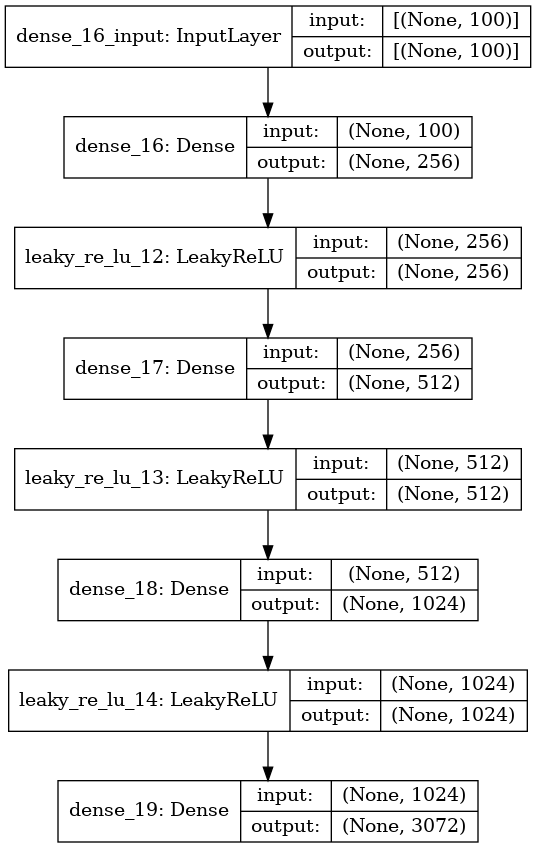

In [45]:
print('Architectures')
print(' ')
print('--- Generator ---')
plot_model(fc_cifar10_generator, show_shapes=True, show_layer_names=True)


--- Discriminator ---


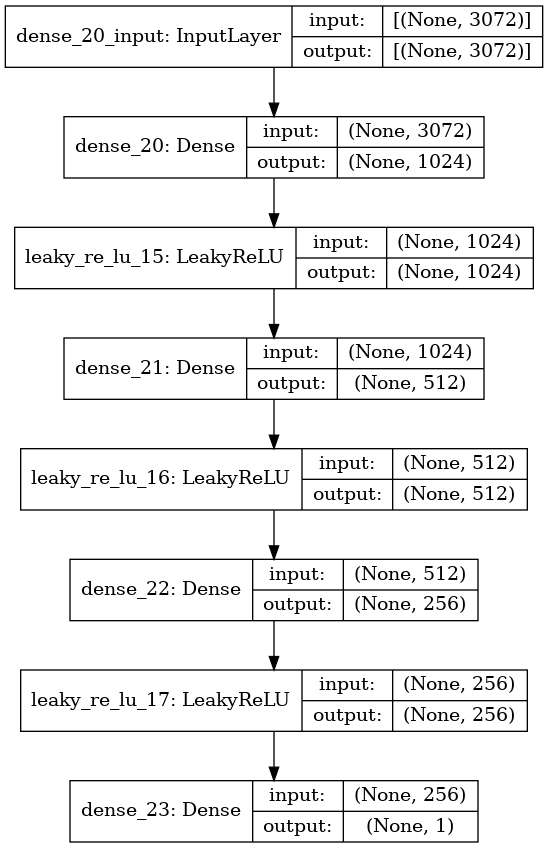

In [46]:
print('--- Discriminator ---')
plot_model(fc_cifar10_discriminator, show_shapes=True, show_layer_names=True)

--- GAN ---


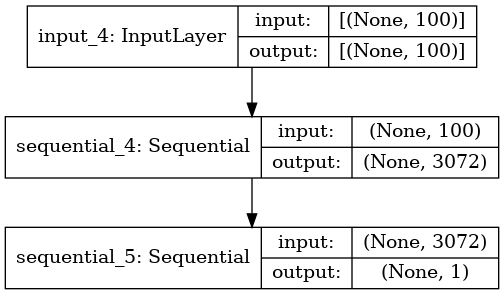

In [47]:
print('--- GAN ---')
plot_model(fc_cifar10_gan, show_shapes=True, show_layer_names=True)

## CIFAR100

In [48]:
# Load data
(x_train, y_train), (x_test, y_test) = cifar100.load_data(label_mode="fine")  

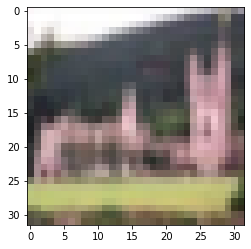

In [49]:
# View one of the samples
plt.imshow(x_train[31])

In [50]:
#Normalise between -1 and 1 and put in appriopriate shape.
x_train = (x_train.astype(np.float32) - 127.5) / 127.5      

x_train = x_train.reshape(-1, img_rows*img_cols*channels)  

### Merge Geneator and Discriminator

In [51]:
fc_cifar100_gan, fc_cifar100_generator, fc_cifar100_discriminator = combine_architecture(create_generator, create_discriminator)

### Train an Print Results

You are on FC-GAN
Epoch: 1 	 Discriminator Loss: 0.683 	 Generator Loss: 1.342 	 FID score: 16.309


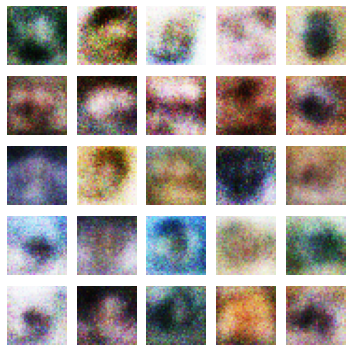

You are on FC-GAN
Epoch: 2 	 Discriminator Loss: 0.758 	 Generator Loss: 1.096 	 FID score: 4.368


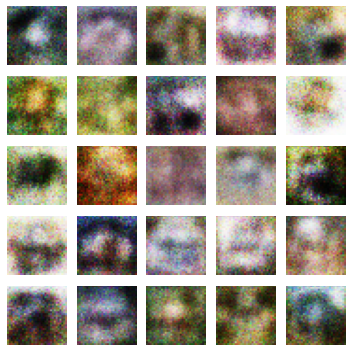

You are on FC-GAN
Epoch: 3 	 Discriminator Loss: 0.554 	 Generator Loss: 1.853 	 FID score: 4.483


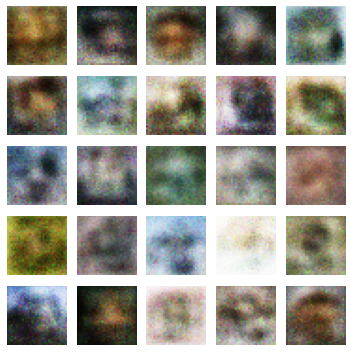

You are on FC-GAN
Epoch: 4 	 Discriminator Loss: 0.496 	 Generator Loss: 1.951 	 FID score: 3.692


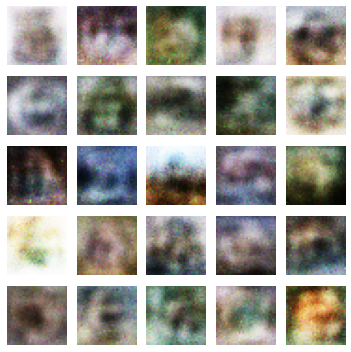

You are on FC-GAN
Epoch: 5 	 Discriminator Loss: 0.663 	 Generator Loss: 2.16 	 FID score: 3.38


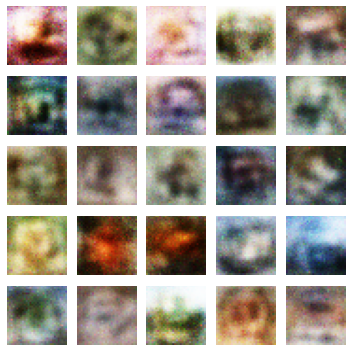

You are on FC-GAN
Epoch: 6 	 Discriminator Loss: 0.533 	 Generator Loss: 3.425 	 FID score: 4.298


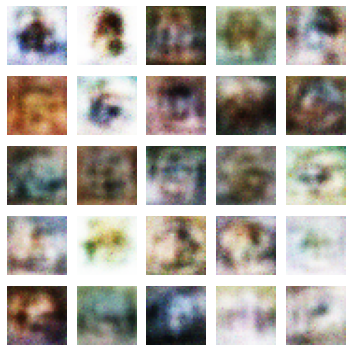

You are on FC-GAN
Epoch: 7 	 Discriminator Loss: 0.461 	 Generator Loss: 4.341 	 FID score: 5.046


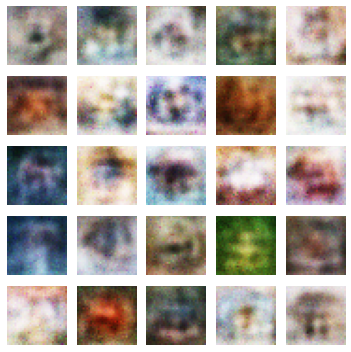

You are on FC-GAN
Epoch: 8 	 Discriminator Loss: 0.395 	 Generator Loss: 2.396 	 FID score: 7.159


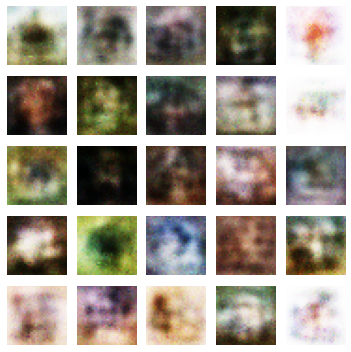

You are on FC-GAN
Epoch: 9 	 Discriminator Loss: 0.435 	 Generator Loss: 2.175 	 FID score: 10.014


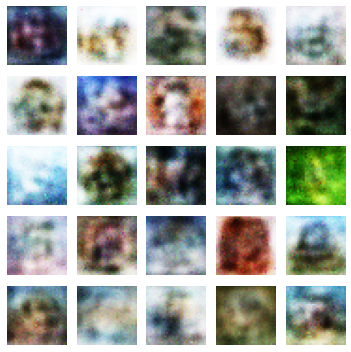

You are on FC-GAN
Epoch: 10 	 Discriminator Loss: 0.371 	 Generator Loss: 2.534 	 FID score: 14.071


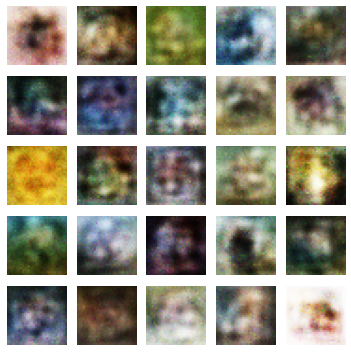

In [52]:
fc_cifar100, fc_cifar100_real, fc_cifar100_fake = train_and_plot_results(fc_cifar100_gan, fc_cifar100_generator, fc_cifar100_discriminator)

In [53]:
fc_cifar100

,epoch,d_loss,g_loss,fid
0,0,0.683340,1.342268,16.309379
0,1,0.758307,1.096191,4.368233
0,2,0.553591,1.852715,4.483464
0,3,0.496455,1.951494,3.692206
0,4,0.662634,2.159596,3.380494
0,5,0.532632,3.424727,4.297819
0,6,0.460583,4.340679,5.046442
0,7,0.394647,2.396091,7.159347
0,8,0.435119,2.175429,10.014395
0,9,0.370788,2.533928,14.070656


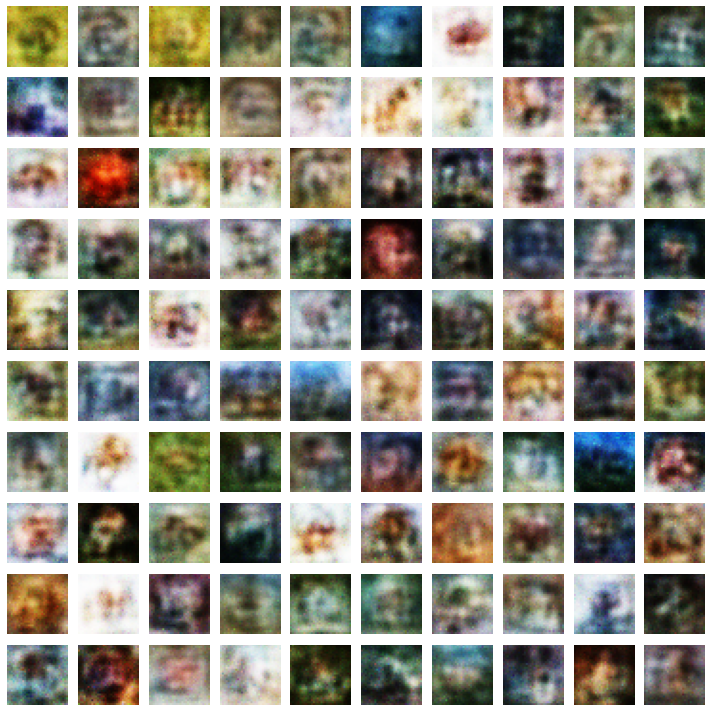

In [54]:
noise = np.random.normal(0, 1, size=(100, noise_dim))
show_images(fc_cifar100_generator, noise, size_fig=(10, 10))

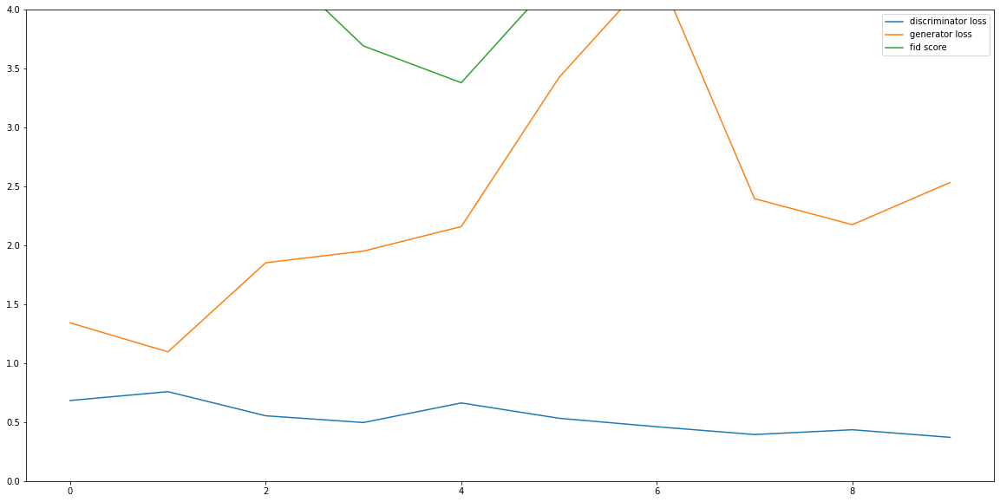

In [55]:
# Plot losses.
plt.figure(figsize=(20, 10))
plt.plot(fc_cifar100['epoch'], fc_cifar100['d_loss'], label='discriminator loss')
plt.plot(fc_cifar100['epoch'], fc_cifar100['g_loss'], label='generator loss')
plt.plot(fc_cifar100['epoch'], fc_cifar100['fid'], label='fid score')
#plt.xlim([0, 1])
plt.ylim([0, 4])
plt.legend()
plt.show()

Finally, we finished training the GAN. We can see that over time, the GAN is definitely getting better. Blurry digits are becoming rarer, and the rest of the images are also getting sharper. Great! Let's just plot the results once again but with more images.

### Model visualisation

In [56]:
print('Architectures')
print(' ')
print('--- Generator ---')
print(fc_cifar100_generator.summary())
print(' ')
print('--- Discriminator ---')
print(fc_cifar100_discriminator.summary())
print(' ')
print('--- GAN ---')
print(fc_cifar100_gan.summary())

Architectures
 
--- Generator ---
Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_24 (Dense)             (None, 256)               25856     
_________________________________________________________________
leaky_re_lu_18 (LeakyReLU)   (None, 256)               0         
_________________________________________________________________
dense_25 (Dense)             (None, 512)               131584    
_________________________________________________________________
leaky_re_lu_19 (LeakyReLU)   (None, 512)               0         
_________________________________________________________________
dense_26 (Dense)             (None, 1024)              525312    
_________________________________________________________________
leaky_re_lu_20 (LeakyReLU)   (None, 1024)              0         
_________________________________________________________________
dense_27 (Dense)    

Architectures
 
--- Generator ---


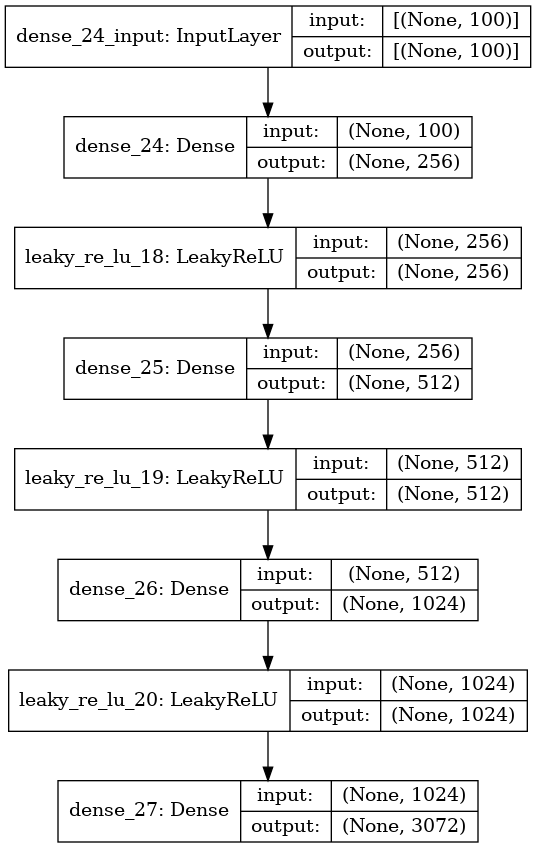

In [57]:
print('Architectures')
print(' ')
print('--- Generator ---')
plot_model(fc_cifar100_generator, show_shapes=True, show_layer_names=True)


--- Discriminator ---


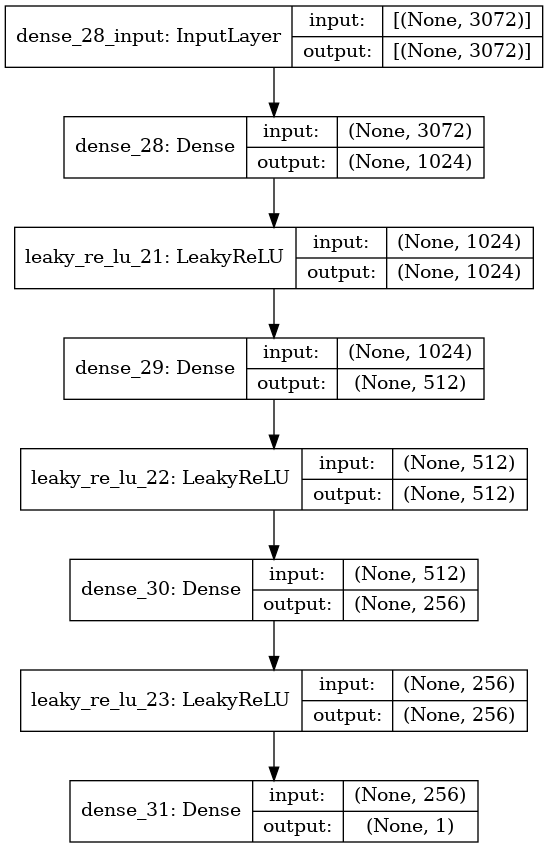

In [58]:
print('--- Discriminator ---')
plot_model(fc_cifar100_discriminator, show_shapes=True, show_layer_names=True)

--- GAN ---


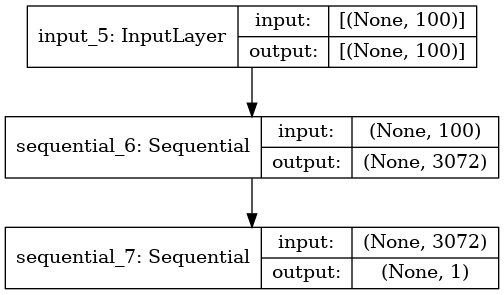

In [59]:
print('--- GAN ---')
plot_model(fc_cifar100_gan, show_shapes=True, show_layer_names=True)

# DCGANs

## MNIST

DCGANs are very similar to FCGANs, the only difference being we add convolutional layers into the generator and the discriminator. Convolutional neural networks can better understand images than standard NNs.

In the DCGAN generator, instead of all the dense layers, we will be using Conv2D and Conv2D Transpose layers. This changes the dimensions the output won't be the same resolution as the image, so we need to reshape the data accordingly.

The DCGAN discriminator looks very similar to a standard Convolutional NN. However, instead of classifying the category of the image, it will classifying whether an image is real or fake.

In [60]:
# Set dimentions of image
img_rows, img_cols, channels = 28, 28, 1

In [61]:
# Load Data

(x_train, y_train), (x_test, y_test) = mnist.load_data()   

x_train = (x_train.astype(np.float32) - 127.5) / 127.5       

x_train = x_train.reshape(-1, img_rows, img_cols, channels) 

### Load the funtions for the DC GAN Model

In [62]:
def create_generator_cgan():
    generator = Sequential()
    
    if img_rows == 32:
        d = 8
    else:
        d = 7
    generator.add(Dense(d*d*256, kernel_initializer=RandomNormal(0, 0.02), input_dim=noise_dim))
    generator.add(LeakyReLU(0.2))     # Use the same leaky relu activation function as the FCGAN.
    
    generator.add(Reshape((d, d, 256)))
    
    generator.add(Conv2DTranspose(128, (4, 4), strides=2, padding='same', kernel_initializer=RandomNormal(0, 0.02)))
    generator.add(LeakyReLU(0.2))

    generator.add(Conv2DTranspose(128, (4, 4), strides=2, padding='same', kernel_initializer=RandomNormal(0, 0.02)))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Conv2D(channels, (3, 3), padding='same', activation='tanh', kernel_initializer=RandomNormal(0, 0.02)))  
    
    generator.compile(loss='binary_crossentropy', optimizer=optimizer)    # The loss doesn't change when you use convolutional layers.
    return generator

In [63]:
def create_discriminator_cgan():
    discriminator = Sequential()
    
    discriminator.add(Conv2D(64, (3, 3), padding='same', kernel_initializer=RandomNormal(0, 0.02), input_shape=(img_cols, img_rows, channels)))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Conv2D(128, (3, 3), strides=2, padding='same', kernel_initializer=RandomNormal(0, 0.02)))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Conv2D(128, (3, 3), strides=2, padding='same', kernel_initializer=RandomNormal(0, 0.02)))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Conv2D(256, (3, 3), strides=2, padding='same', kernel_initializer=RandomNormal(0, 0.02)))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Flatten())
    discriminator.add(Dropout(0.4))
    discriminator.add(Dense(1, activation='sigmoid', input_shape=(img_cols, img_rows, channels)))
    
    discriminator.compile(loss='binary_crossentropy', optimizer=optimizer) 
    return discriminator

### Merge Geneator and Discriminator

In [64]:
dc_mnist_gan, dc_mnist_generator, dc_mnist_discriminator = combine_architecture(create_generator_cgan, create_discriminator_cgan)

### Train an Print Results

You are on DC-GAN
Epoch: 1 	 Discriminator Loss: 0.488 	 Generator Loss: 1.902 	 FID score: 3.84


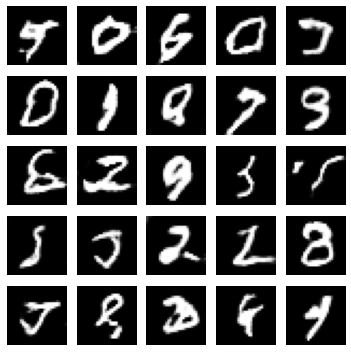

You are on DC-GAN
Epoch: 2 	 Discriminator Loss: 0.617 	 Generator Loss: 1.181 	 FID score: 1.045


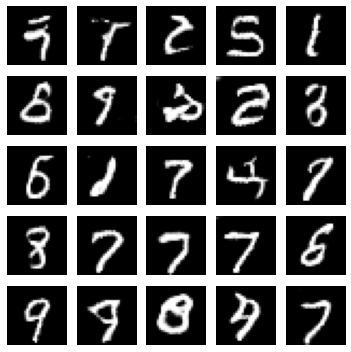

You are on DC-GAN
Epoch: 3 	 Discriminator Loss: 0.421 	 Generator Loss: 1.649 	 FID score: 1.24


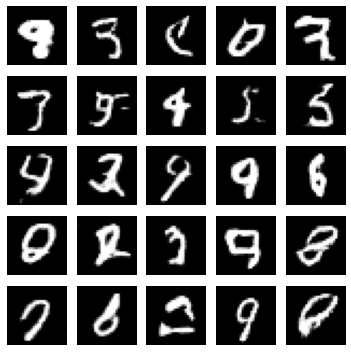

You are on DC-GAN
Epoch: 4 	 Discriminator Loss: 0.571 	 Generator Loss: 1.397 	 FID score: 1.14


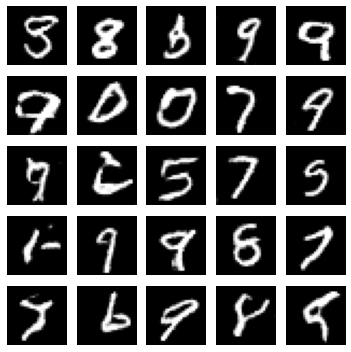

You are on DC-GAN
Epoch: 5 	 Discriminator Loss: 0.374 	 Generator Loss: 2.074 	 FID score: 1.19


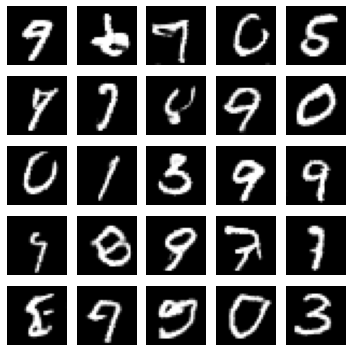

You are on DC-GAN
Epoch: 6 	 Discriminator Loss: 0.642 	 Generator Loss: 1.952 	 FID score: 1.237


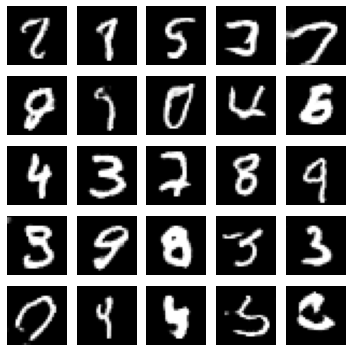

You are on DC-GAN
Epoch: 7 	 Discriminator Loss: 0.612 	 Generator Loss: 1.693 	 FID score: 1.116


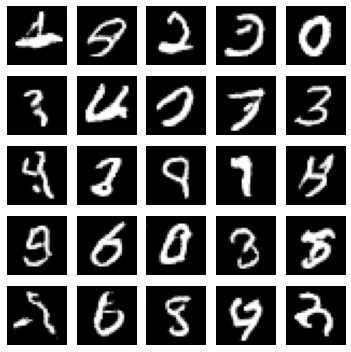

You are on DC-GAN
Epoch: 8 	 Discriminator Loss: 0.56 	 Generator Loss: 1.366 	 FID score: 1.416


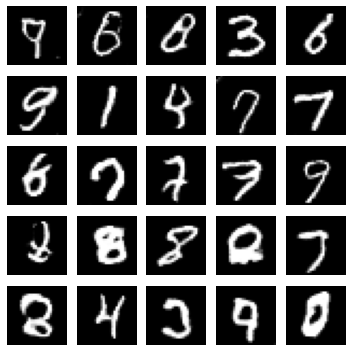

You are on DC-GAN
Epoch: 9 	 Discriminator Loss: 0.622 	 Generator Loss: 1.482 	 FID score: 1.703


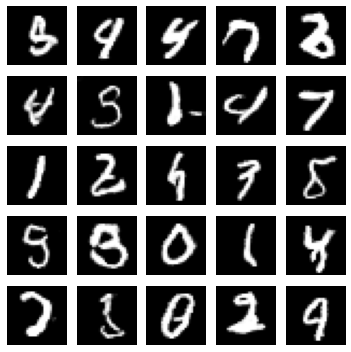

You are on DC-GAN
Epoch: 10 	 Discriminator Loss: 0.481 	 Generator Loss: 1.933 	 FID score: 1.566


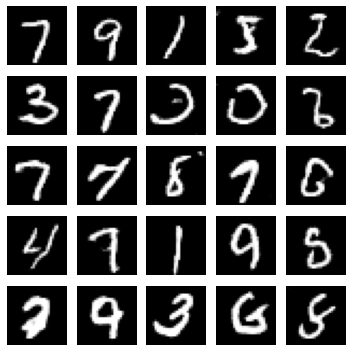

In [65]:
dc_mnist, dc_mnist_real, dc_mnist_fake = train_and_plot_results(dc_mnist_gan, dc_mnist_generator, dc_mnist_discriminator)

In [66]:
dc_mnist

,epoch,d_loss,g_loss,fid
0,0,0.488353,1.902314,3.840326
0,1,0.616638,1.180811,1.045407
0,2,0.421387,1.649433,1.239532
0,3,0.571494,1.396928,1.139529
0,4,0.374072,2.074377,1.189644
0,5,0.641939,1.952084,1.236659
0,6,0.611637,1.692747,1.115806
0,7,0.559637,1.365755,1.416344
0,8,0.621666,1.481716,1.703335
0,9,0.480706,1.932779,1.565726


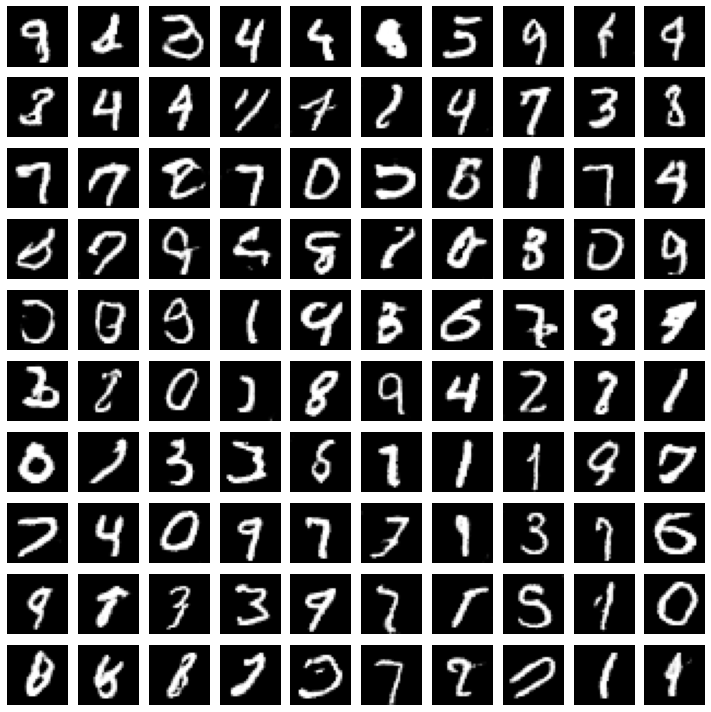

In [67]:
# Plot results again.
noise = np.random.normal(0, 1, size=(100, noise_dim))
show_images(dc_mnist_generator, noise, size_fig=(10, 10))

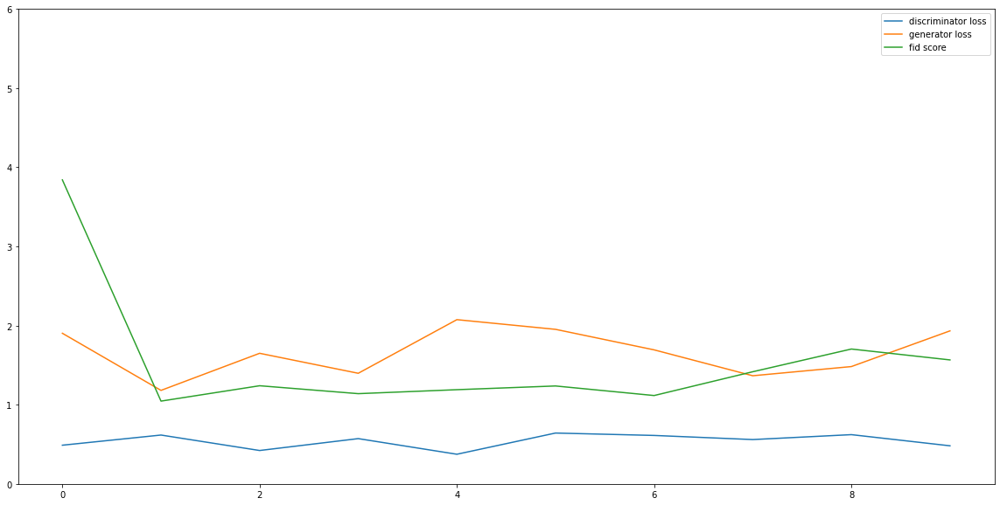

In [68]:
# Plot losses.
plt.figure(figsize=(20, 10))
plt.plot(dc_mnist['epoch'], dc_mnist['d_loss'], label='discriminator loss')
plt.plot(dc_mnist['epoch'], dc_mnist['g_loss'], label='generator loss')
plt.plot(dc_mnist['epoch'], dc_mnist['fid'], label='fid score')
#plt.xlim([0, 1])
plt.ylim([0, 6])
plt.legend()
plt.show()

### Model Visualisation

In [69]:
print('Architectures')
print(' ')
print('--- Generator ---')
print(dc_mnist_generator.summary())
print(' ')
print('--- Discriminator ---')
print(dc_mnist_discriminator.summary())
print(' ')
print('--- GAN ---')
print(dc_mnist_gan.summary())

Architectures
 
--- Generator ---
Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_32 (Dense)             (None, 12544)             1266944   
_________________________________________________________________
leaky_re_lu_24 (LeakyReLU)   (None, 12544)             0         
_________________________________________________________________
reshape (Reshape)            (None, 7, 7, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 14, 14, 128)       524416    
_________________________________________________________________
leaky_re_lu_25 (LeakyReLU)   (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 28, 28, 128)       262272    
_________________________________________________________________
leaky_re_lu_26 (Leak

Architectures
 
--- Generator ---


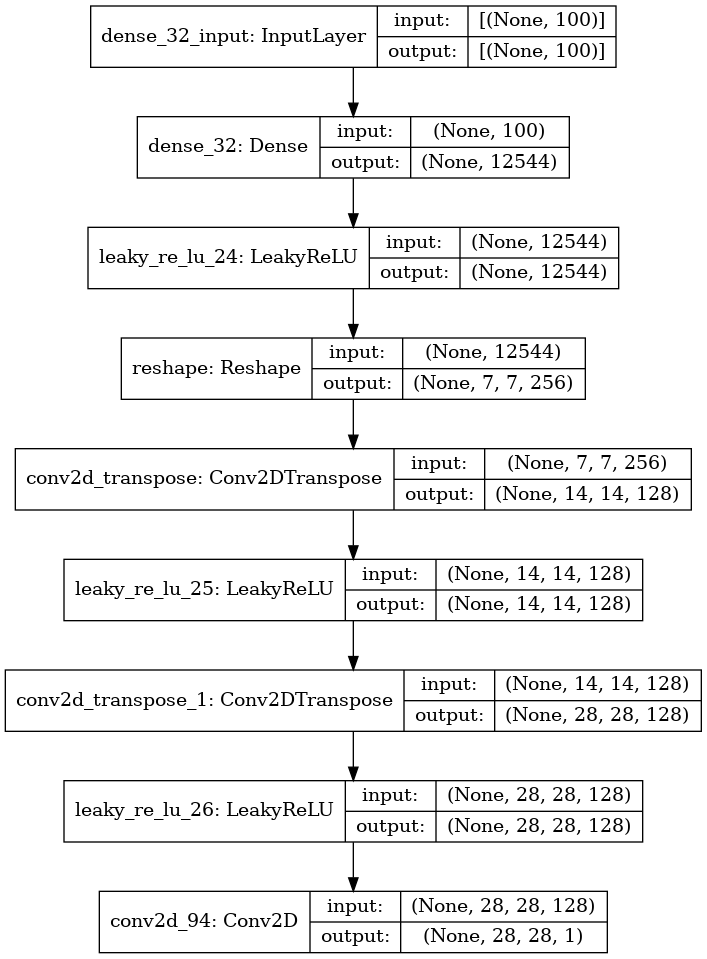

In [70]:
from keras.utils.vis_utils import plot_model
print('Architectures')
print(' ')
print('--- Generator ---')
plot_model(dc_mnist_generator, show_shapes=True, show_layer_names=True)


--- Discriminator ---


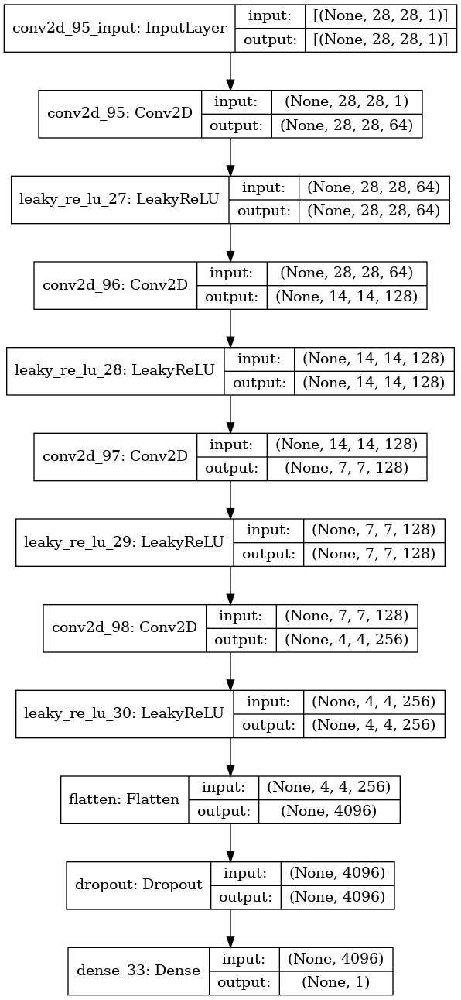

In [71]:
print('--- Discriminator ---')
plot_model(dc_mnist_discriminator, show_shapes=True, show_layer_names=True)

--- GAN ---


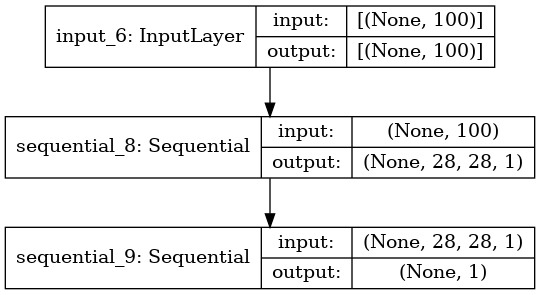

In [72]:
print('--- GAN ---')
plot_model(dc_mnist_gan, show_shapes=True, show_layer_names=True)

## Fashion MNIST

In [73]:
# Load Data 

(x_train, y_train), (x_test, y_test) = fashion_mnist.load_data()   #Load the data

x_train = (x_train.astype(np.float32) - 127.5) / 127.5       #Normalize the images again so that the pixel value is from -1 to 1

x_train = x_train.reshape(-1, img_rows, img_cols, channels)  #Reshaping the data into a more NN friendly format

### Merge Geneator and Discriminator

In [74]:
dc_fashion_mnist_gan, dc_fashion_mnist_generator, dc_fashion_mnist_discriminator = combine_architecture(create_generator_cgan, create_discriminator_cgan)

### Train an Print Results

You are on DC-GAN
Epoch: 1 	 Discriminator Loss: 0.503 	 Generator Loss: 1.449 	 FID score: 12.459


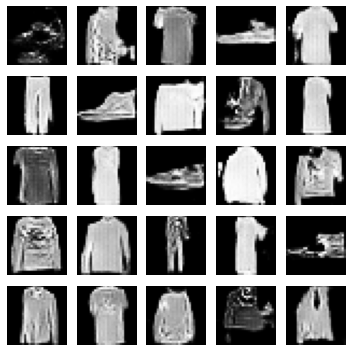

You are on DC-GAN
Epoch: 2 	 Discriminator Loss: 0.55 	 Generator Loss: 1.181 	 FID score: 25.075


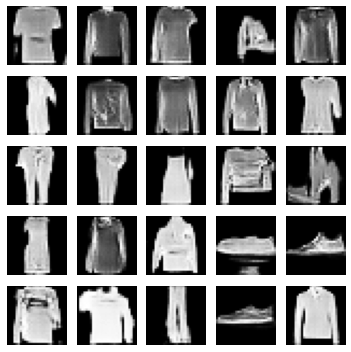

You are on DC-GAN
Epoch: 3 	 Discriminator Loss: 0.622 	 Generator Loss: 1.304 	 FID score: 24.969


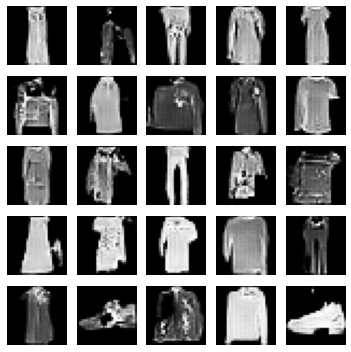

You are on DC-GAN
Epoch: 4 	 Discriminator Loss: 0.586 	 Generator Loss: 1.27 	 FID score: 28.986


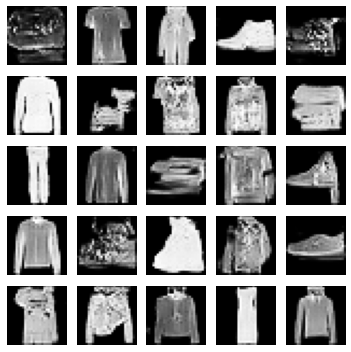

You are on DC-GAN
Epoch: 5 	 Discriminator Loss: 0.571 	 Generator Loss: 1.448 	 FID score: 29.225


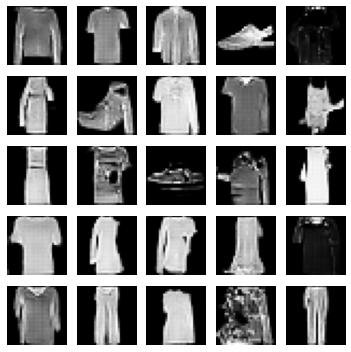

You are on DC-GAN
Epoch: 6 	 Discriminator Loss: 0.544 	 Generator Loss: 1.429 	 FID score: 33.767


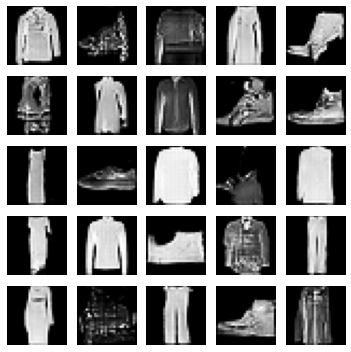

You are on DC-GAN
Epoch: 7 	 Discriminator Loss: 0.545 	 Generator Loss: 1.627 	 FID score: 33.195


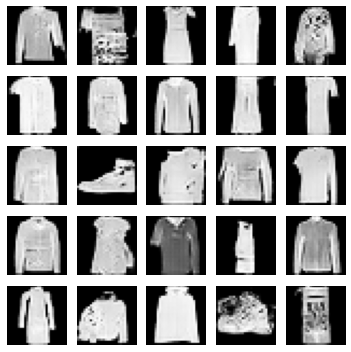

You are on DC-GAN
Epoch: 8 	 Discriminator Loss: 0.597 	 Generator Loss: 1.246 	 FID score: 32.834


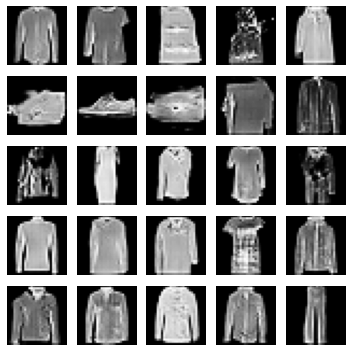

You are on DC-GAN
Epoch: 9 	 Discriminator Loss: 0.463 	 Generator Loss: 1.851 	 FID score: 34.551


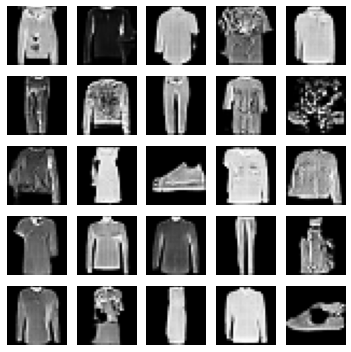

You are on DC-GAN
Epoch: 10 	 Discriminator Loss: 0.547 	 Generator Loss: 1.498 	 FID score: 38.062


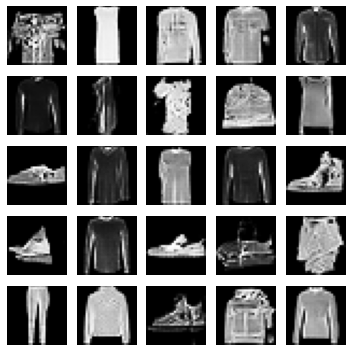

In [75]:
dc_fashion_mnist, dc_fashion_mnist_real, dc_fashion_mnist_fake = train_and_plot_results(dc_fashion_mnist_gan, dc_fashion_mnist_generator, dc_fashion_mnist_discriminator)

In [76]:
dc_fashion_mnist

,epoch,d_loss,g_loss,fid
0,0,0.503006,1.449473,12.459278
0,1,0.549562,1.181293,25.075329
0,2,0.622089,1.304096,24.968518
0,3,0.586369,1.269762,28.986476
0,4,0.570659,1.447536,29.224659
0,5,0.544080,1.429135,33.766618
0,6,0.544624,1.627478,33.194591
0,7,0.597402,1.246103,32.834119
0,8,0.462812,1.850537,34.550871
0,9,0.547187,1.497591,38.062264


# INVESTIGATE WHY FID FOR DC-GAN, MNIST_FASHION IS NOT REDUCING

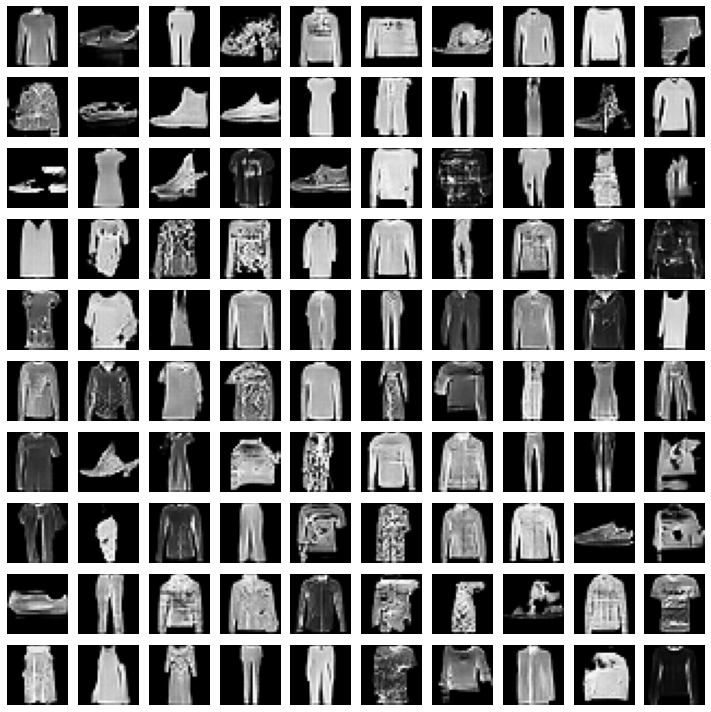

In [77]:
# Plot results again.
noise = np.random.normal(0, 1, size=(100, noise_dim))
show_images(dc_fashion_mnist_generator, noise, size_fig=(10, 10))

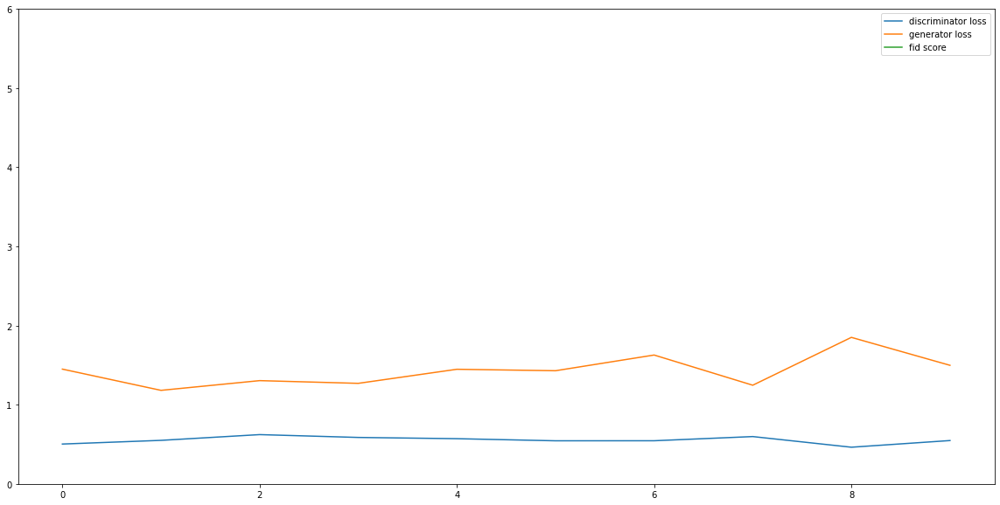

In [80]:
# Plot losses.
plt.figure(figsize=(20, 10))
plt.plot(dc_fashion_mnist['epoch'], dc_fashion_mnist['d_loss'], label='discriminator loss')
plt.plot(dc_fashion_mnist['epoch'], dc_fashion_mnist['g_loss'], label='generator loss')
plt.plot(dc_fashion_mnist['epoch'], dc_fashion_mnist['fid'], label='fid score')
#plt.xlim([0, 1])
plt.ylim([0, 6])
plt.legend()
plt.show()

### Model visualisation

In [81]:
print('Architectures')
print(' ')
print('--- Generator ---')
print(dc_fashion_mnist_generator.summary())
print(' ')
print('--- Discriminator ---')
print(dc_fashion_mnist_discriminator.summary())
print(' ')
print('--- GAN ---')
print(dc_fashion_mnist_gan.summary())

Architectures
 
--- Generator ---
Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_34 (Dense)             (None, 12544)             1266944   
_________________________________________________________________
leaky_re_lu_31 (LeakyReLU)   (None, 12544)             0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 7, 7, 256)         0         
_________________________________________________________________
conv2d_transpose_2 (Conv2DTr (None, 14, 14, 128)       524416    
_________________________________________________________________
leaky_re_lu_32 (LeakyReLU)   (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_transpose_3 (Conv2DTr (None, 28, 28, 128)       262272    
_________________________________________________________________
leaky_re_lu_33 (Lea

Architectures
 
--- Generator ---


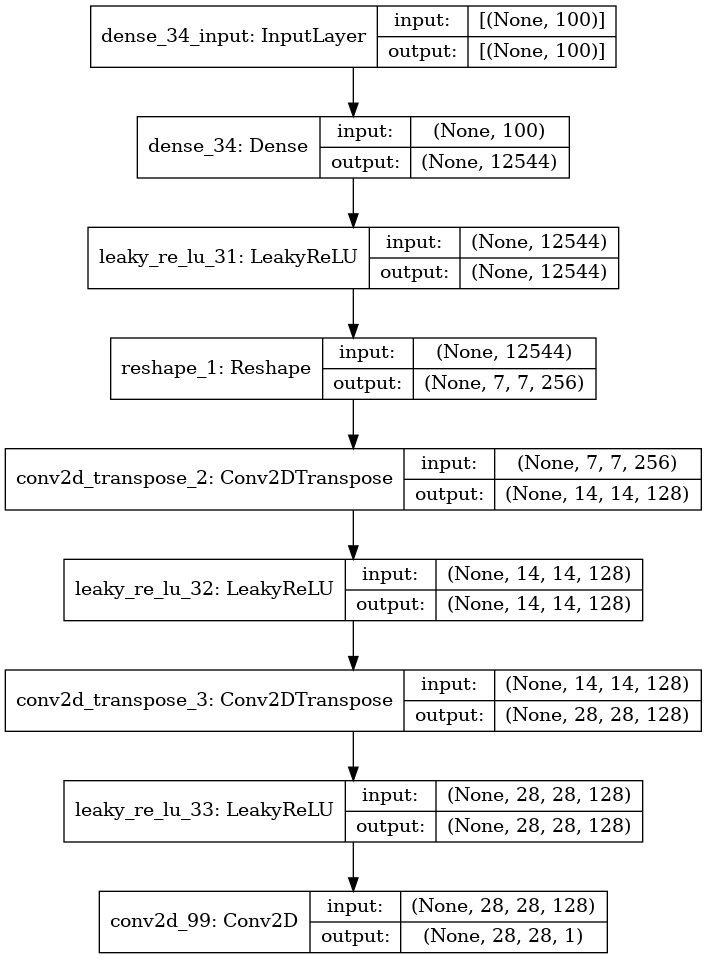

In [82]:
from keras.utils.vis_utils import plot_model
print('Architectures')
print(' ')
print('--- Generator ---')
plot_model(dc_fashion_mnist_generator, show_shapes=True, show_layer_names=True)


--- Discriminator ---


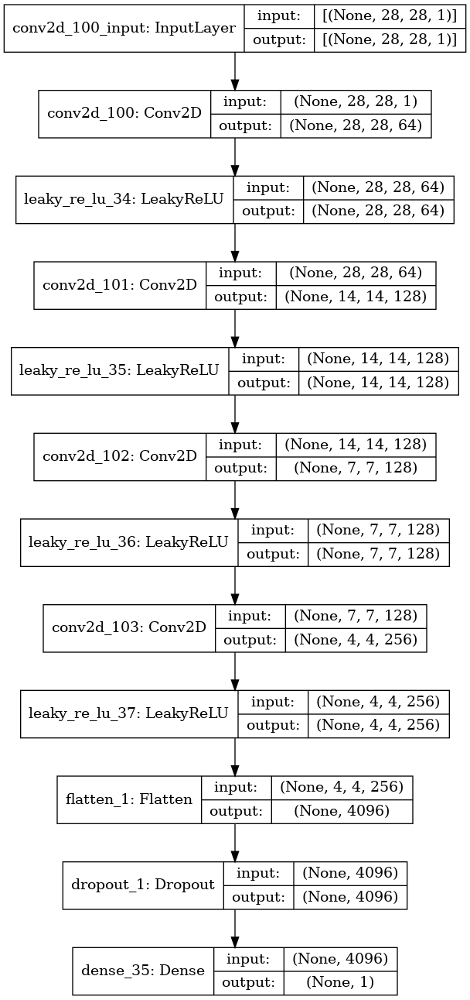

In [83]:
print('--- Discriminator ---')
plot_model(dc_fashion_mnist_discriminator, show_shapes=True, show_layer_names=True)

--- GAN ---


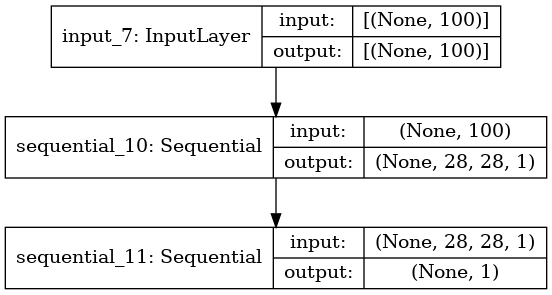

In [84]:
print('--- GAN ---')
plot_model(dc_fashion_mnist_gan, show_shapes=True, show_layer_names=True)

## CIFAR10

In [85]:
# Changed to CIFAR dimensions.
img_rows, img_cols, channels = 32, 32, 3

In [86]:
# Load Data 

(x_train, y_train), (x_test, y_test) = cifar10.load_data()
x_train = (x_train.astype(np.float32) - 127.5) / 127.5       
x_train = x_train.reshape(-1, img_rows, img_cols, channels) 

### Merge Geneator and Discriminator

In [87]:
dc_cifar10_gan, dc_cifar10_generator, dc_cifar10_discriminator = combine_architecture(create_generator_cgan, create_discriminator_cgan)

### Train an Print Results

You are on DC-GAN
Epoch: 1 	 Discriminator Loss: 0.64 	 Generator Loss: 0.91 	 FID score: 10.503


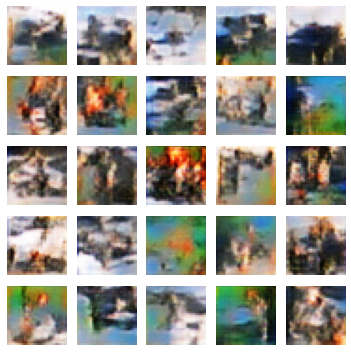

You are on DC-GAN
Epoch: 2 	 Discriminator Loss: 0.703 	 Generator Loss: 0.832 	 FID score: 4.057


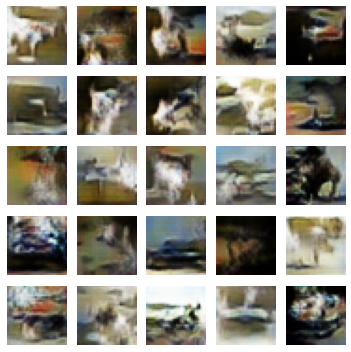

You are on DC-GAN
Epoch: 3 	 Discriminator Loss: 0.661 	 Generator Loss: 1.037 	 FID score: 2.945


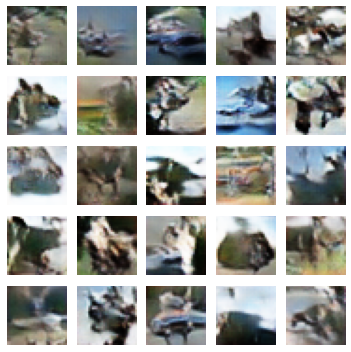

You are on DC-GAN
Epoch: 4 	 Discriminator Loss: 0.6 	 Generator Loss: 1.029 	 FID score: 1.938


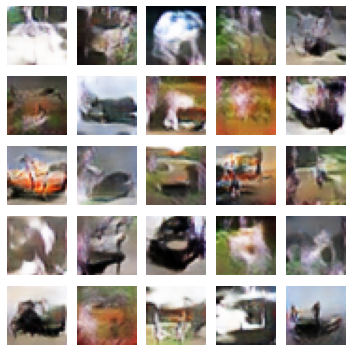

You are on DC-GAN
Epoch: 5 	 Discriminator Loss: 0.586 	 Generator Loss: 1.127 	 FID score: 2.0


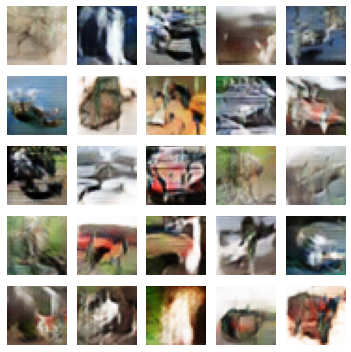

You are on DC-GAN
Epoch: 6 	 Discriminator Loss: 0.651 	 Generator Loss: 1.021 	 FID score: 2.651


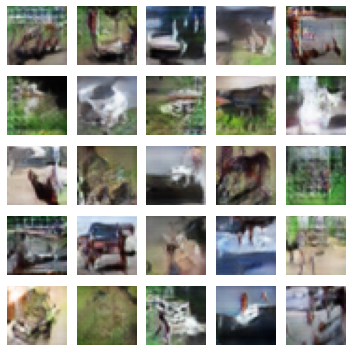

You are on DC-GAN
Epoch: 7 	 Discriminator Loss: 0.671 	 Generator Loss: 1.083 	 FID score: 2.625


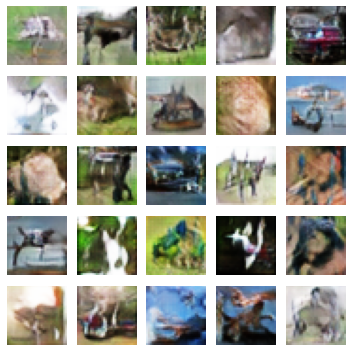

You are on DC-GAN
Epoch: 8 	 Discriminator Loss: 0.568 	 Generator Loss: 1.336 	 FID score: 2.762


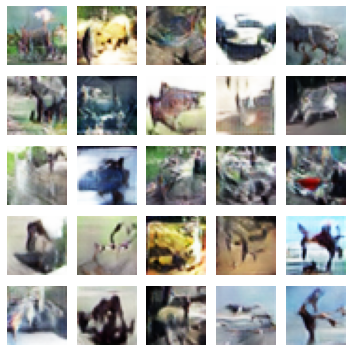

You are on DC-GAN
Epoch: 9 	 Discriminator Loss: 0.547 	 Generator Loss: 1.216 	 FID score: 2.573


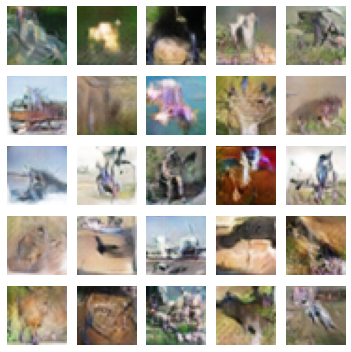

You are on DC-GAN
Epoch: 10 	 Discriminator Loss: 0.591 	 Generator Loss: 1.259 	 FID score: 3.197


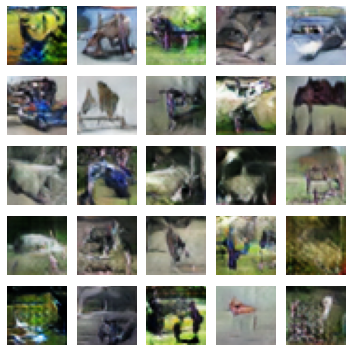

In [88]:
dc_cifar10, dc_cifar10_real, dc_cifar10_fake = train_and_plot_results(dc_cifar10_gan, dc_cifar10_generator, dc_cifar10_discriminator)

In [89]:
dc_cifar10

,epoch,d_loss,g_loss,fid
0,0,0.640220,0.910083,10.502723
0,1,0.702519,0.831720,4.057211
0,2,0.661498,1.036713,2.945239
0,3,0.599744,1.028561,1.938128
0,4,0.585738,1.126563,2.000239
0,5,0.651328,1.020873,2.651314
0,6,0.670736,1.083175,2.624511
0,7,0.568161,1.336011,2.761676
0,8,0.547184,1.216152,2.573326
0,9,0.590942,1.258550,3.196839


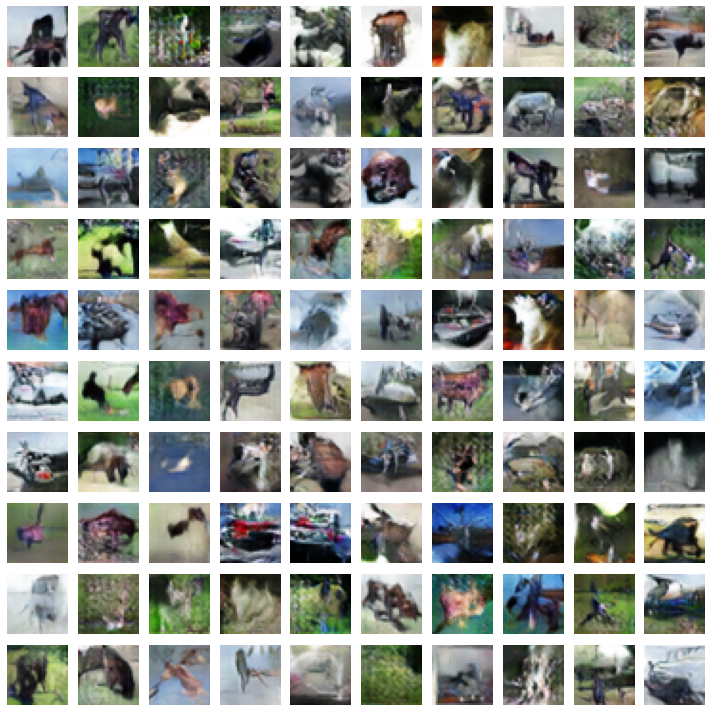

In [90]:
noise = np.random.normal(0, 1, size=(100, noise_dim))
show_images(dc_cifar10_generator, noise, (10, 10))

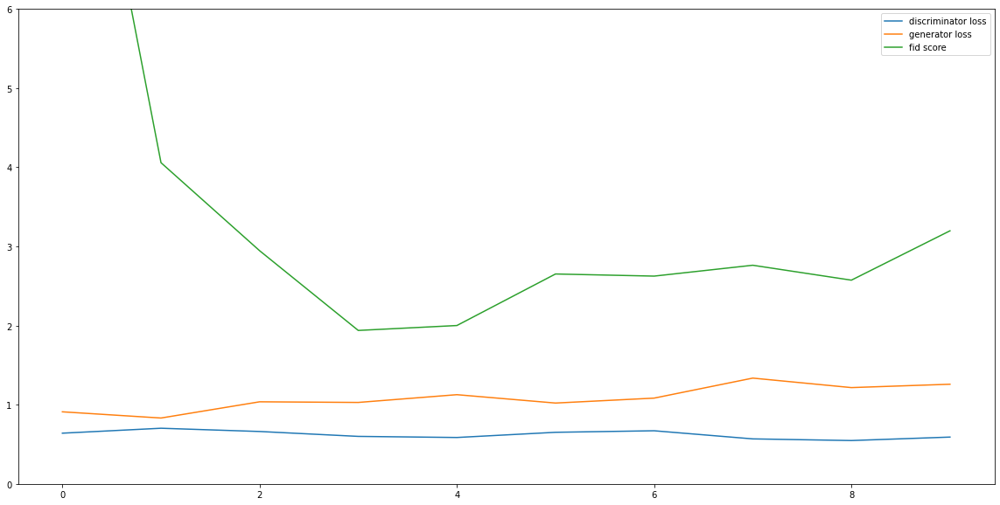

In [91]:
# Plot losses.
plt.figure(figsize=(20, 10))
plt.plot(dc_cifar10['epoch'], dc_cifar10['d_loss'], label='discriminator loss')
plt.plot(dc_cifar10['epoch'], dc_cifar10['g_loss'], label='generator loss')
plt.plot(dc_cifar10['epoch'], dc_cifar10['fid'], label='fid score')
#plt.xlim([0, 1])
plt.ylim([0, 6])
plt.legend()
plt.show()

### Model visualisation

In [92]:
print('Architectures')
print(' ')
print('--- Generator ---')
print(dc_cifar10_generator.summary())
print(' ')
print('--- Discriminator ---')
print(dc_cifar10_discriminator.summary())
print(' ')
print('--- GAN ---')
print(dc_cifar10_gan.summary())

Architectures
 
--- Generator ---
Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_36 (Dense)             (None, 16384)             1654784   
_________________________________________________________________
leaky_re_lu_38 (LeakyReLU)   (None, 16384)             0         
_________________________________________________________________
reshape_2 (Reshape)          (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose_4 (Conv2DTr (None, 16, 16, 128)       524416    
_________________________________________________________________
leaky_re_lu_39 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_transpose_5 (Conv2DTr (None, 32, 32, 128)       262272    
_________________________________________________________________
leaky_re_lu_40 (Lea

Architectures
 
--- Generator ---


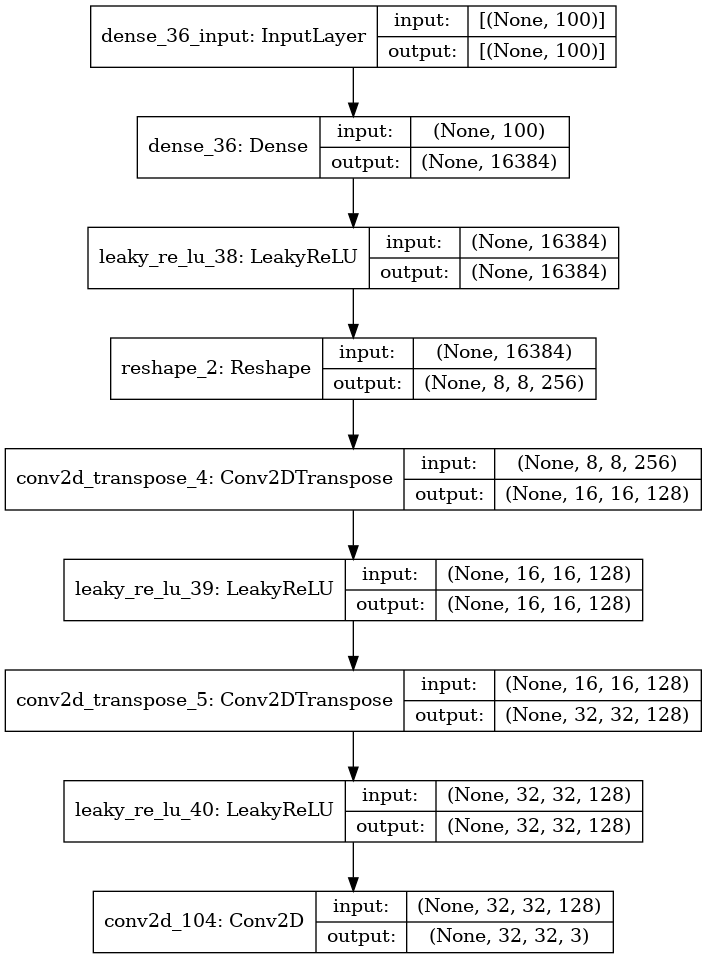

In [93]:
from keras.utils.vis_utils import plot_model
print('Architectures')
print(' ')
print('--- Generator ---')
plot_model(dc_cifar10_generator, show_shapes=True, show_layer_names=True)


--- Discriminator ---


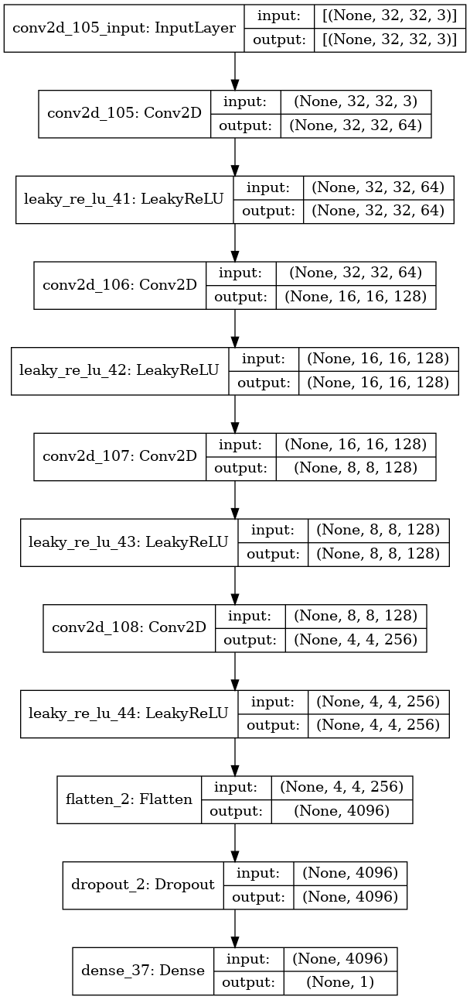

In [96]:
print('--- Discriminator ---')
plot_model(dc_cifar10_discriminator, show_shapes=True, show_layer_names=True)

--- GAN ---


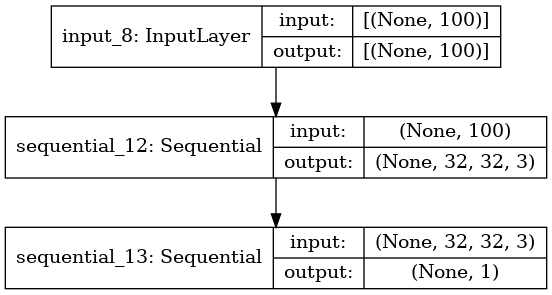

In [99]:
print('--- GAN ---')
plot_model(dc_cifar10_gan, show_shapes=True, show_layer_names=True)

## CIFAR100

In [100]:
# Load Data 

(x_train, y_train), (x_test, y_test) = cifar100.load_data()   

x_train = (x_train.astype(np.float32) - 127.5) / 127.5       

x_train = x_train.reshape(-1, img_rows, img_cols, channels)  

### Merge Geneator and Discriminator

In [101]:
dc_cifar100_gan, dc_cifar100_generator, dc_cifar100_discriminator = combine_architecture(create_generator_cgan, create_discriminator_cgan)

### Train an Print Results

You are on DC-GAN
Epoch: 1 	 Discriminator Loss: 0.589 	 Generator Loss: 0.889 	 FID score: 15.318


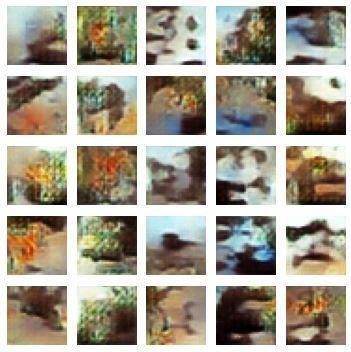

You are on DC-GAN
Epoch: 2 	 Discriminator Loss: 0.697 	 Generator Loss: 0.96 	 FID score: 6.645


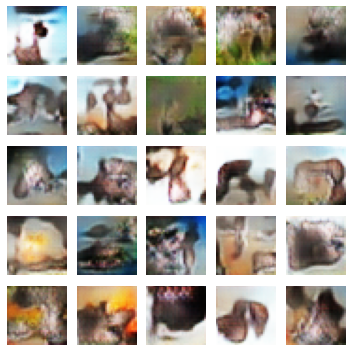

You are on DC-GAN
Epoch: 3 	 Discriminator Loss: 0.617 	 Generator Loss: 1.017 	 FID score: 4.907


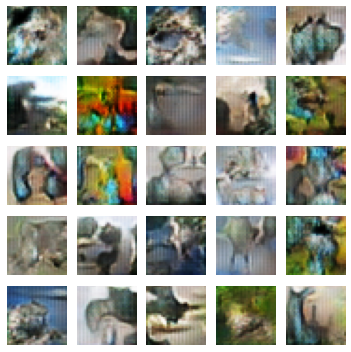

You are on DC-GAN
Epoch: 4 	 Discriminator Loss: 0.608 	 Generator Loss: 0.995 	 FID score: 5.785


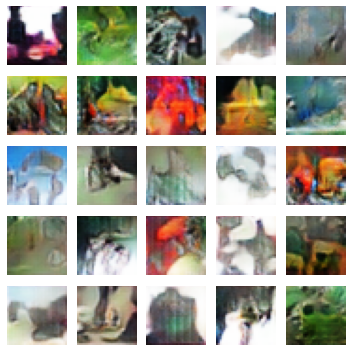

You are on DC-GAN
Epoch: 5 	 Discriminator Loss: 0.693 	 Generator Loss: 0.907 	 FID score: 4.923


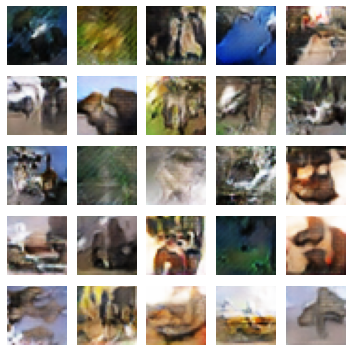

You are on DC-GAN
Epoch: 6 	 Discriminator Loss: 0.586 	 Generator Loss: 1.106 	 FID score: 5.129


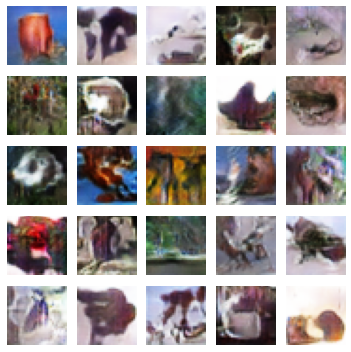

You are on DC-GAN
Epoch: 7 	 Discriminator Loss: 0.622 	 Generator Loss: 1.13 	 FID score: 5.081


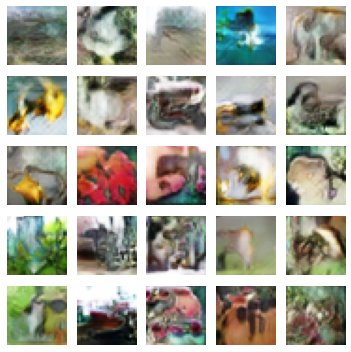

You are on DC-GAN
Epoch: 8 	 Discriminator Loss: 0.58 	 Generator Loss: 1.453 	 FID score: 5.315


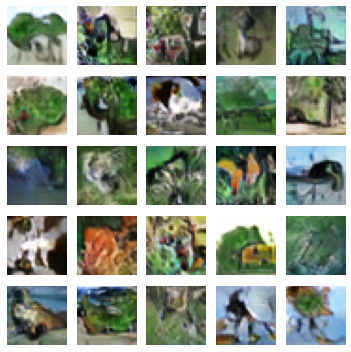

You are on DC-GAN
Epoch: 9 	 Discriminator Loss: 0.56 	 Generator Loss: 1.284 	 FID score: 5.609


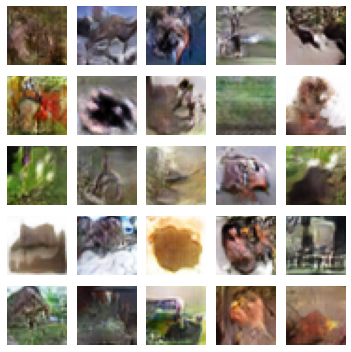

You are on DC-GAN
Epoch: 10 	 Discriminator Loss: 0.579 	 Generator Loss: 1.118 	 FID score: 5.382


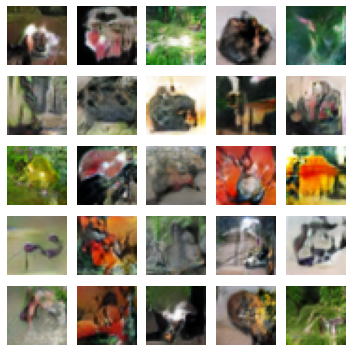

In [102]:
dc_cifar100, dc_cifar100_real, dc_cifar100_fake = train_and_plot_results(dc_cifar100_gan, dc_cifar100_generator, dc_cifar100_discriminator)

In [103]:
dc_cifar100

,epoch,d_loss,g_loss,fid
0,0,0.589001,0.889076,15.317863
0,1,0.697064,0.959652,6.644723
0,2,0.616877,1.017176,4.906563
0,3,0.608286,0.994714,5.784633
0,4,0.692933,0.906915,4.922820
0,5,0.586076,1.105829,5.128615
0,6,0.622266,1.130126,5.081123
0,7,0.580054,1.453098,5.314778
0,8,0.560391,1.284145,5.608555
0,9,0.578863,1.117628,5.382319


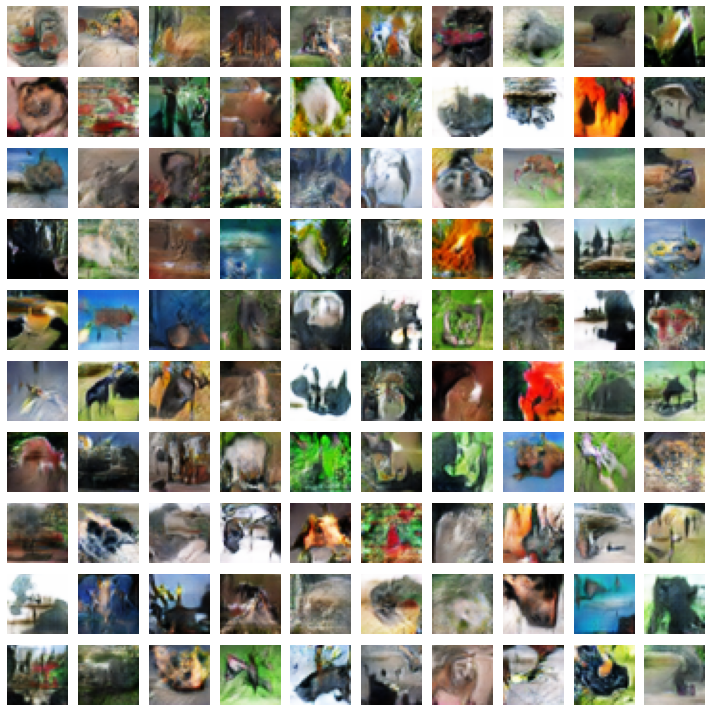

In [104]:
# Plot results again.
noise = np.random.normal(0, 1, size=(100, noise_dim))
show_images(dc_cifar100_generator, noise, (10, 10))

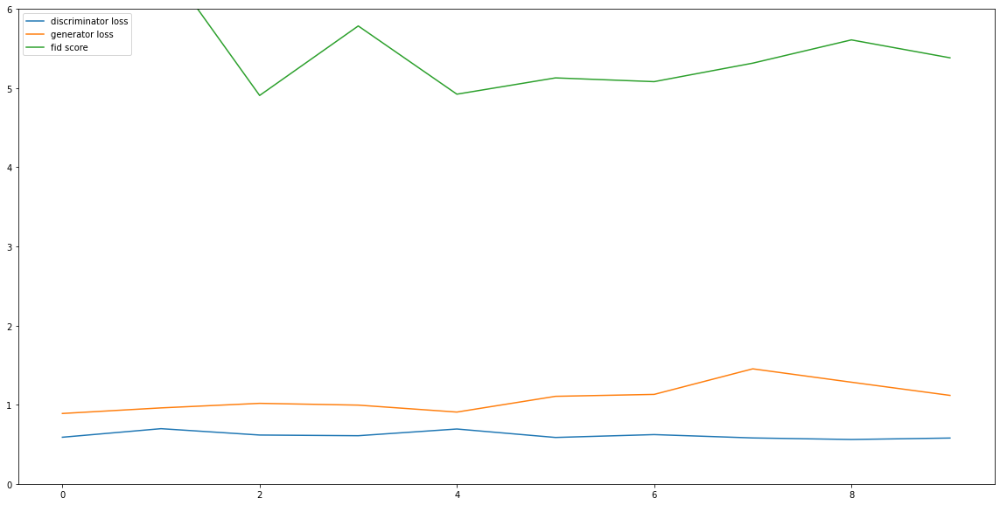

In [105]:
# Plot losses.
plt.figure(figsize=(20, 10))
plt.plot(dc_cifar100['epoch'], dc_cifar100['d_loss'], label='discriminator loss')
plt.plot(dc_cifar100['epoch'], dc_cifar100['g_loss'], label='generator loss')
plt.plot(dc_cifar100['epoch'], dc_cifar100['fid'], label='fid score')
#plt.xlim([0, 1])
plt.ylim([0, 6])
plt.legend()
plt.show()

### Model visualisation

In [106]:
print('Architectures')
print(' ')
print('--- Generator ---')
print(dc_cifar100_generator.summary())
print(' ')
print('--- Discriminator ---')
print(dc_cifar100_discriminator.summary())
print(' ')
print('--- GAN ---')
print(dc_cifar100_gan.summary())

Architectures
 
--- Generator ---
Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_38 (Dense)             (None, 16384)             1654784   
_________________________________________________________________
leaky_re_lu_45 (LeakyReLU)   (None, 16384)             0         
_________________________________________________________________
reshape_3 (Reshape)          (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose_6 (Conv2DTr (None, 16, 16, 128)       524416    
_________________________________________________________________
leaky_re_lu_46 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_transpose_7 (Conv2DTr (None, 32, 32, 128)       262272    
_________________________________________________________________
leaky_re_lu_47 (Lea

Architectures
 
--- Generator ---


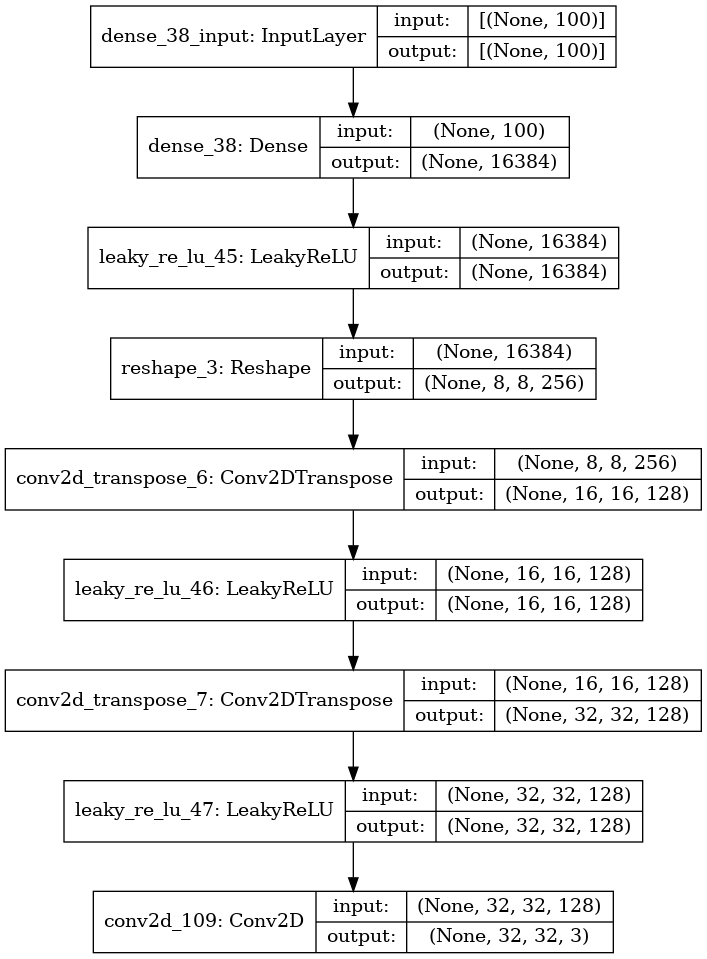

In [107]:
from keras.utils.vis_utils import plot_model
print('Architectures')
print(' ')
print('--- Generator ---')
plot_model(dc_cifar100_generator, show_shapes=True, show_layer_names=True)


--- Discriminator ---


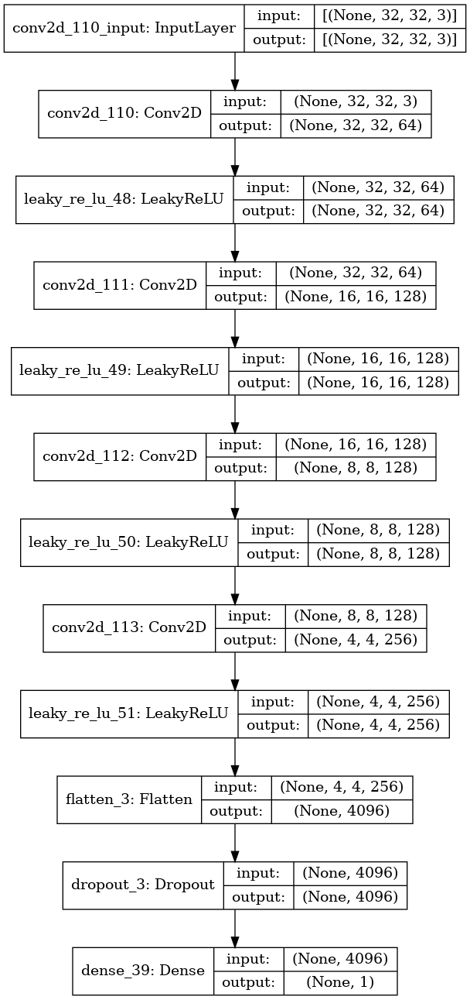

In [108]:
print('--- Discriminator ---')
plot_model(dc_cifar100_discriminator, show_shapes=True, show_layer_names=True)

--- GAN ---


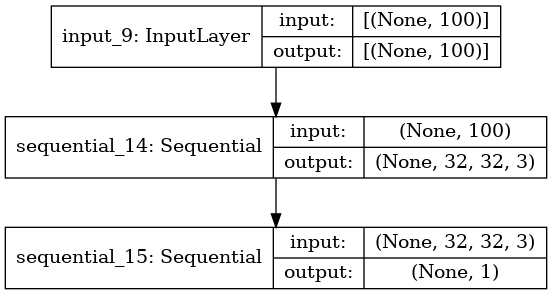

In [109]:
print('--- GAN ---')
plot_model(dc_cifar100_gan, show_shapes=True, show_layer_names=True)

# Results


From the generated images, it can be seen:
- Over time, the generated images get more lifelike.



## FC-GAN vs. DC-GAN

In [110]:
### MNIST Dataset

In [112]:
# fid between real images and fake
# To compare, each dataset, we will compare the fake images of FC-Gan and the Fake images of DC-GAN
# against the real images of that dataset.

datasets = ['MNIST', 'FASHION_MNIST', 'CIFAR10', 'CIFAR100']

real_images_FC_GAN = [fc_mnist_real, fc_fashion_mnist_real, fc_cifar10_real, fc_cifar100_real]
fake_images_FC_GAN = [fc_mnist_fake, fc_fashion_mnist_fake, fc_cifar10_fake, fc_cifar100_fake]

real_images_DC_GAN = [dc_mnist_real, dc_fashion_mnist_real, dc_cifar10_real, dc_cifar100_real]
fake_images_DC_GAN = [dc_mnist_fake, dc_fashion_mnist_fake, dc_cifar10_fake, dc_cifar100_fake]

# real images of DC and FC GANs are the same but here.

FC = []
DC = []
dataset = []

for i in range(len(datasets)):
    fid_fc = calculate_fid(model, real_images_FC_GAN[i], fake_images_FC_GAN[i])
    FC.append(fid_fc)
    
    fid_dc = calculate_fid(model, real_images_DC_GAN[i], fake_images_DC_GAN[i])
    DC.append(fid_dc)

dataset.append(FC)
dataset.append(DC)

FID_table = pd.DataFrame(dataset, columns=datasets, index=['FC-GAN', 'DC_GAN'])

print(FID_table)

           MNIST  FASHION_MNIST   CIFAR10   CIFAR100
FC-GAN  2.737715       4.070218  7.829290  14.070656
DC_GAN  1.565726      38.062264  3.196839   5.382319


Limitations and improvements include:
- Number of epochs could be increased.
- Number of layers and neurons in layers could be increased.
- Experiment with optimisers, activation and loss functions.
- Experiment with other GANs such as Cycle GANs and Style GANs.


In [113]:
FID_table

,MNIST,FASHION_MNIST,CIFAR10,CIFAR100
FC-GAN,2.737715,4.070218,7.829290,14.070656
DC_GAN,1.565726,38.062264,3.196839,5.382319
